In [28]:
from IPython.display import display, Javascript

display(Javascript('''
$('div.input').hide();
'''))


<IPython.core.display.Javascript object>

In [1]:
import json
from datetime import datetime

def is_new_format_field(field_value):
    """
    Returns True if the field (expected to be a dict) follows the new format,
    i.e. it has keys that are timestamp strings and their values are dicts that include a "timestamp" key.
    """
    if isinstance(field_value, dict):
        for k, v in field_value.items():
            if isinstance(v, dict) and "timestamp" in v:
                return True
    return False

def uses_new_format(entry):
    """
    Returns True if any of the fields dailyTriggers, dailySymptoms, or dailyHelpers
    in this entry follow the new format.
    """
    for field in ["dailyTriggers", "dailySymptoms", "dailyHelpers"]:
        if field in entry:
            if is_new_format_field(entry[field]):
                return True
    return False

with open('/home/shaheerhumayun/Desktop/fall 24-25/sproj_migraine/migraineaid-csalt-default-rtdb-export(11).json', 'r') as file:
    data = json.load(file)

user_entries = {}
first_seen_dates = {}

# Define the cutoff: only consider entries from January 28, 2025 onwards.
cutoff_timestamp = datetime(2025, 1, 28).timestamp()

# Iterate over users
for user_id, user_data in data.get("users", {}).items():
    daily_updates = user_data.get("dailyUpdates", {})
    entry_dates = set()
    first_seen = None
    
    # Some users may have migraineLogs (which is new) even if some daily entries lack the new fields.
    has_migraine_logs = "migraineLogs" in user_data
    
    for year, year_data in daily_updates.items():
        if isinstance(year_data, list):
            year_data = {str(i): v for i, v in enumerate(year_data) if isinstance(v, dict)}
        for month, month_data in year_data.items():
            if isinstance(month_data, list):
                month_data = {str(i): v for i, v in enumerate(month_data) if isinstance(v, dict)}
            for day, entry in month_data.items():
                if "entryTimestamp" in entry:
                    try:
                        timestamp = entry["entryTimestamp"]
                        dt = datetime.fromtimestamp(timestamp).date()
                        
                        if timestamp >= cutoff_timestamp and (uses_new_format(entry) or has_migraine_logs):
                            if first_seen is None:
                                first_seen = timestamp
                            entry_dates.add(dt)
                    except Exception as e:
                        print(f"Error parsing timestamp for user {user_id}, date {year}-{month}-{day}: {e}")
    
    total_entries = len(entry_dates) 
    if total_entries > 0:
        user_entries[user_id] = total_entries
        if first_seen:
            first_seen_dates[user_id] = datetime.fromtimestamp(first_seen).strftime("%Y-%m-%d")

print(f"\nTotal users processed: {len(user_entries)}")
for user_id, entry_count in user_entries.items():
    first_seen = first_seen_dates.get(user_id, "Unknown")
    print(f"User ID: {user_id} - Unique Entry Days (from Jan 28, 2025 onwards): {entry_count}, First Seen: {first_seen}")



Total users processed: 18
User ID: 0Z4R7AuQNIT7mx3kw30c4gKHPQ93 - Unique Entry Days (from Jan 28, 2025 onwards): 3, First Seen: 2025-02-10
User ID: 0eV50zjgBcN7iHzjZlhTML7yWSm1 - Unique Entry Days (from Jan 28, 2025 onwards): 2, First Seen: 2025-01-29
User ID: 60nbTTrkaNZrqOBocU03j6Jl1Zq2 - Unique Entry Days (from Jan 28, 2025 onwards): 13, First Seen: 2025-02-15
User ID: ELxHa881bEPiJ6w3HUWLfVP0ZxC3 - Unique Entry Days (from Jan 28, 2025 onwards): 15, First Seen: 2025-01-29
User ID: Qm9YlAxAdRMKDCyDePxaj2rgx3k1 - Unique Entry Days (from Jan 28, 2025 onwards): 13, First Seen: 2025-01-29
User ID: TroIjiUCjsdtCrXpE4MsXxHS68h2 - Unique Entry Days (from Jan 28, 2025 onwards): 27, First Seen: 2025-01-29
User ID: UbDrbFvC1id1qKqNxGLAkIQ5wAQ2 - Unique Entry Days (from Jan 28, 2025 onwards): 13, First Seen: 2025-03-10
User ID: W9D2BlUQRzZkd1O8R8odfM51hbE3 - Unique Entry Days (from Jan 28, 2025 onwards): 1, First Seen: 2025-02-07
User ID: YwkUJbOPNIfm4NEcYDIvnF67vNv2 - Unique Entry Days (from 

In [2]:
import json
from datetime import datetime

def is_new_format_field(field_value):
    """Checks if a field follows the new format with timestamp keys."""
    if isinstance(field_value, dict):
        for v in field_value.values():
            if isinstance(v, dict) and "timestamp" in v:
                return True
    return False

def uses_new_format(entry):
    """Checks if any of the daily fields use the new format."""
    return any(field in entry and is_new_format_field(entry[field]) for field in ["dailyTriggers", "dailySymptoms", "dailyHelpers"])

# Load JSON file
with open('/home/shaheerhumayun/Desktop/fall 24-25/sproj_migraine/migraineaid-csalt-default-rtdb-export(11).json', 'r') as file:
    data = json.load(file)

user_entry_details = {}
user_new_format_start = {}  # Track first occurrence of new format per user

# First pass: Determine the earliest timestamp where the new format appears for each user
for user_id, user_data in data.get("users", {}).items():
    daily_updates = user_data.get("dailyUpdates", {})
    migraine_logs = user_data.get("migraineLogs", {})

    first_seen = None

    # Check migraineLogs for earliest timestamp
    if isinstance(migraine_logs, dict):
        migraine_timestamps = [int(ts) for ts in migraine_logs.keys() if ts.isdigit()]
        if migraine_timestamps:
            first_seen = min(migraine_timestamps) / 1000  # Convert ms → seconds

    # Check dailyUpdates for earliest new-format entry
    for year, year_data in daily_updates.items():
        if isinstance(year_data, list):
            year_data = {str(i): v for i, v in enumerate(year_data) if isinstance(v, dict)}
        for month, month_data in year_data.items():
            if isinstance(month_data, list):
                month_data = {str(i): v for i, v in enumerate(month_data) if isinstance(v, dict)}
            for day, entry in month_data.items():
                if "entryTimestamp" in entry:
                    entry_timestamp = entry["entryTimestamp"]
                    if uses_new_format(entry):
                        if first_seen is None or entry_timestamp < first_seen:
                            first_seen = entry_timestamp  # Update first occurrence

    # Store the first occurrence of the new format for the user
    if first_seen:
        user_new_format_start[user_id] = first_seen

# Second pass: Collect user entries, only considering data from their new format start timestamp
for user_id, user_data in data.get("users", {}).items():
    daily_updates = user_data.get("dailyUpdates", {})

    if user_id not in user_new_format_start:
        continue  # Skip users who never had the new format

    first_new_format_ts = user_new_format_start[user_id]

    for year, year_data in daily_updates.items():
        if isinstance(year_data, list):
            year_data = {str(i): v for i, v in enumerate(year_data) if isinstance(v, dict)}
        for month, month_data in year_data.items():
            if isinstance(month_data, list):
                month_data = {str(i): v for i, v in enumerate(month_data) if isinstance(v, dict)}
            for day, entry in month_data.items():
                if "entryTimestamp" in entry:
                    try:
                        entry_timestamp = entry["entryTimestamp"]
                        migraine_timestamp = entry.get("migraineStartTimestamp")  # Stored in milliseconds

                        if entry_timestamp >= first_new_format_ts:  # Only consider data after new format appeared
                            if user_id not in user_entry_details:
                                user_entry_details[user_id] = []

                            # Convert timestamps
                            entry_time_str = datetime.fromtimestamp(entry_timestamp).strftime("%Y-%m-%d %H:%M:%S")

                            if migraine_timestamp:
                                migraine_timestamp /= 1000  # Convert ms → seconds
                                migraine_time_str = datetime.fromtimestamp(migraine_timestamp).strftime("%Y-%m-%d %H:%M:%S")
                                migraine_info = f"Yes (Migraine at {migraine_time_str})"
                            else:
                                migraine_info = "No"

                            user_entry_details[user_id].append((entry_timestamp, entry_time_str, migraine_info))
                    except Exception as e:
                        print(f"Error parsing timestamps for user {user_id}, date {year}-{month}-{day}: {e}")

# Filter users with more than 5 entries
filtered_users = {user_id: entries for user_id, entries in user_entry_details.items() if len(entries) > 5}

# Print summary
print(f"Total users with more than 5 entries: {len(filtered_users)}")
for user_id, entries in filtered_users.items():
    print(f"\nUser ID: {user_id} ({len(entries)} entries)")
    print(f"  First new format seen at: {datetime.fromtimestamp(user_new_format_start[user_id]).strftime('%Y-%m-%d %H:%M:%S')}")
    for entry_ts, entry_time, migraine_info in sorted(entries, key=lambda x: x[0]):
        print(f"  Entry Timestamp: {entry_ts} ({entry_time}), Had Migraine: {migraine_info}")


Total users with more than 5 entries: 10

User ID: 0eV50zjgBcN7iHzjZlhTML7yWSm1 (6 entries)
  First new format seen at: 2025-01-09 16:02:29
  Entry Timestamp: 1736420549 (2025-01-09 16:02:29), Had Migraine: No
  Entry Timestamp: 1736705220 (2025-01-12 23:07:00), Had Migraine: Yes (Migraine at 2025-01-12 23:28:36)
  Entry Timestamp: 1737618051 (2025-01-23 12:40:51), Had Migraine: Yes (Migraine at 2025-01-23 12:40:24)
  Entry Timestamp: 1738135200 (2025-01-29 12:20:00), Had Migraine: Yes (Migraine at 2025-01-29 12:19:15)
  Entry Timestamp: 1738176293 (2025-01-29 23:44:53), Had Migraine: Yes (Migraine at 2025-01-30 06:16:01)
  Entry Timestamp: 1738902882 (2025-02-07 09:34:42), Had Migraine: No

User ID: 60nbTTrkaNZrqOBocU03j6Jl1Zq2 (13 entries)
  First new format seen at: 2025-02-15 20:08:47
  Entry Timestamp: 1739632127 (2025-02-15 20:08:47), Had Migraine: No
  Entry Timestamp: 1739702948 (2025-02-16 15:49:08), Had Migraine: No
  Entry Timestamp: 1739770534 (2025-02-17 10:35:34), Had Mig

In [3]:
filtered_users

{'0eV50zjgBcN7iHzjZlhTML7yWSm1': [(1736420549, '2025-01-09 16:02:29', 'No'),
  (1736705220, '2025-01-12 23:07:00', 'Yes (Migraine at 2025-01-12 23:28:36)'),
  (1737618051, '2025-01-23 12:40:51', 'Yes (Migraine at 2025-01-23 12:40:24)'),
  (1738135200, '2025-01-29 12:20:00', 'Yes (Migraine at 2025-01-29 12:19:15)'),
  (1738176293, '2025-01-29 23:44:53', 'Yes (Migraine at 2025-01-30 06:16:01)'),
  (1738902882, '2025-02-07 09:34:42', 'No')],
 '60nbTTrkaNZrqOBocU03j6Jl1Zq2': [(1739632127, '2025-02-15 20:08:47', 'No'),
  (1739702948, '2025-02-16 15:49:08', 'No'),
  (1739770534, '2025-02-17 10:35:34', 'Yes (Migraine at 2025-02-17 07:35:34)'),
  (1739860311, '2025-02-18 11:31:51', 'No'),
  (1739935265, '2025-02-19 08:21:05', 'No'),
  (1740133739, '2025-02-21 15:28:59', 'No'),
  (1740195213, '2025-02-22 08:33:33', 'No'),
  (1740285372, '2025-02-23 09:36:12', 'No'),
  (1740387492, '2025-02-24 13:58:12', 'No'),
  (1740547074, '2025-02-26 10:17:54', 'No'),
  (1740637931, '2025-02-27 11:32:11', 'N

In [4]:
def calculate_reading_frequency(timestamps):
    if len(timestamps) < 2:
        return "Insufficient data"
    intervals = [t2 - t1 for t1, t2 in zip(timestamps[:-1], timestamps[1:])]
    avg_interval = sum(intervals) / len(intervals)
    if avg_interval < 900:
        return "Every 15 minutes"
    elif avg_interval < 1800:
        return "Every 30 minutes"
    else:
        return "More than 30 minutes"

for user_id in filtered_users.keys():
    user_data = data["users"][user_id]
    data_collection = user_data.get("dataCollection", {})
    if data_collection:
        unique_sensors = set()
        luminance_timestamps = []
        for sensor_data in data_collection.values():
            unique_sensors.update(sensor_data.keys())
            if "luminance" in sensor_data:
                # Fix: Handle single timestamp
                timestamp = sensor_data.get("timestamp")
                if isinstance(timestamp, int):
                    luminance_timestamps.append(timestamp)
                elif isinstance(timestamp, list):
                    luminance_timestamps.extend(timestamp)
                elif timestamp is not None:
                    print(f"Warning: Unexpected timestamp format for user {user_id}")
        
        unique_sensors.discard("timestamp")
        if unique_sensors:
            print(f"User ID: {user_id}")
            print("  Unique Sensor Information:")
            for sensor in unique_sensors:
                print(f"    Sensor: {sensor}")
            if luminance_timestamps:
                luminance_timestamps.sort()
                frequency = calculate_reading_frequency(luminance_timestamps)
                print(f"  Luminance Reading Frequency: {frequency}")
            else:
                print("  No luminance readings available.")
        else:
            print(f"User ID: {user_id} - No unique sensor information available.")
    else:
        print(f"User ID: {user_id} - No sensor information available.")

User ID: 0eV50zjgBcN7iHzjZlhTML7yWSm1
  Unique Sensor Information:
    Sensor: luminance
    Sensor: latitude
    Sensor: longitude
    Sensor: audioPath
    Sensor: stepRecords
  Luminance Reading Frequency: More than 30 minutes
User ID: 60nbTTrkaNZrqOBocU03j6Jl1Zq2
  Unique Sensor Information:
    Sensor: luminance
  Luminance Reading Frequency: More than 30 minutes
User ID: ELxHa881bEPiJ6w3HUWLfVP0ZxC3
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  Luminance Reading Frequency: More than 30 minutes
User ID: Qm9YlAxAdRMKDCyDePxaj2rgx3k1
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  Luminance Reading Frequency: More than 30 minutes
User ID: TroIjiUCjsdtCrXpE4MsXxHS68h2
  Unique Sensor Information:
    Sensor: luminance
  Luminance Reading Frequency: More than 30 minutes
User ID: UbDrbFvC1id1qKqNxGLAkIQ5wAQ2
  Unique Sensor Information:
    Sensor: luminance
  Luminance Reading Frequency: 

In [5]:
from tabulate import tabulate

def calculate_reading_frequency(timestamps):
    if len(timestamps) < 2:
        return "Insufficient data"
    intervals = [t2 - t1 for t1, t2 in zip(timestamps[:-1], timestamps[1:])]
    avg_interval = sum(intervals) / len(intervals)
    if avg_interval < 900:
        return "Every 15 minutes"
    elif avg_interval < 1800:
        return "Every 30 minutes"
    else:
        return "More than 30 minutes"

# Collect data for table
results = []

for user_id in filtered_users.keys():
    user_data = data["users"][user_id]
    data_collection = user_data.get("dataCollection", {})
    if data_collection:
        unique_sensors = set()
        luminance_timestamps = []
        for sensor_data in data_collection.values():
            unique_sensors.update(sensor_data.keys())
            if "luminance" in sensor_data:
                timestamp = sensor_data.get("timestamp")
                if isinstance(timestamp, int):
                    luminance_timestamps.append(timestamp)
                elif isinstance(timestamp, list):
                    luminance_timestamps.extend(timestamp)
                elif timestamp is not None:
                    print(f"Warning: Unexpected timestamp format for user {user_id}")

        unique_sensors.discard("timestamp")
        sensors_list = ', '.join(sorted(unique_sensors)) if unique_sensors else "None"
        if luminance_timestamps:
            luminance_timestamps.sort()
            frequency = calculate_reading_frequency(luminance_timestamps)
        else:
            frequency = "No luminance data"
    else:
        sensors_list = "No data"
        frequency = "No data"

    results.append([user_id, sensors_list, frequency])

# Print as a table
headers = ["User ID", "Sensor Types", "Luminance Frequency"]
print(tabulate(results, headers=headers, tablefmt="grid"))


+------------------------------+--------------------------------------------------------+-----------------------+
| User ID                      | Sensor Types                                           | Luminance Frequency   |
+==============================+========================================================+=======================+
| 0eV50zjgBcN7iHzjZlhTML7yWSm1 | audioPath, latitude, longitude, luminance, stepRecords | More than 30 minutes  |
+------------------------------+--------------------------------------------------------+-----------------------+
| 60nbTTrkaNZrqOBocU03j6Jl1Zq2 | luminance                                              | More than 30 minutes  |
+------------------------------+--------------------------------------------------------+-----------------------+
| ELxHa881bEPiJ6w3HUWLfVP0ZxC3 | latitude, longitude, luminance                         | More than 30 minutes  |
+------------------------------+--------------------------------------------------------

In [6]:
import csv
import os

def calculate_intervals(timestamps):
    if len(timestamps) < 2:
        return []
    intervals = [(t2 - t1) / 60000 for t1, t2 in zip(timestamps[:-1], timestamps[1:])]  # Convert to minutes
    return intervals

def save_intervals_to_csv(user_id, intervals):
    output_directory = "luminance_intervals"
    os.makedirs(output_directory, exist_ok=True)
    file_path = os.path.join(output_directory, f"user_{user_id}_luminance_intervals.csv")
    
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(["Interval (minutes)"])
        for interval in intervals:
            writer.writerow([interval])

for user_id in filtered_users.keys():
    user_data = data["users"][user_id]
    data_collection = user_data.get("dataCollection", {})
    if data_collection:
        unique_sensors = set()
        luminance_timestamps = []
        for sensor_data in data_collection.values():
            unique_sensors.update(sensor_data.keys())
            if "luminance" in sensor_data:
                timestamp = sensor_data.get("timestamp")
                if isinstance(timestamp, int):
                    luminance_timestamps.append(timestamp)
                elif isinstance(timestamp, list):
                    luminance_timestamps.extend(timestamp)
                elif timestamp is not None:
                    print(f"Warning: Unexpected timestamp format for user {user_id}")
        
        unique_sensors.discard("timestamp")
        if unique_sensors:
            print(f"User ID: {user_id}")
            print("  Unique Sensor Information:")
            for sensor in unique_sensors:
                print(f"    Sensor: {sensor}")
            if luminance_timestamps:
                luminance_timestamps.sort()
                intervals = calculate_intervals(luminance_timestamps)
                if intervals:
                    save_intervals_to_csv(user_id, intervals)
                    print(f"  Luminance Reading Intervals saved for User {user_id}")
                else:
                    print("  Insufficient luminance readings to calculate intervals.")
            else:
                print("  No luminance readings available.")
        else:
            print(f"User ID: {user_id} - No unique sensor information available.")
    else:
        print(f"User ID: {user_id} - No sensor information available.")

User ID: 0eV50zjgBcN7iHzjZlhTML7yWSm1
  Unique Sensor Information:
    Sensor: luminance
    Sensor: latitude
    Sensor: longitude
    Sensor: audioPath
    Sensor: stepRecords
  Luminance Reading Intervals saved for User 0eV50zjgBcN7iHzjZlhTML7yWSm1
User ID: 60nbTTrkaNZrqOBocU03j6Jl1Zq2
  Unique Sensor Information:
    Sensor: luminance
  Luminance Reading Intervals saved for User 60nbTTrkaNZrqOBocU03j6Jl1Zq2
User ID: ELxHa881bEPiJ6w3HUWLfVP0ZxC3
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  Luminance Reading Intervals saved for User ELxHa881bEPiJ6w3HUWLfVP0ZxC3
User ID: Qm9YlAxAdRMKDCyDePxaj2rgx3k1
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  Luminance Reading Intervals saved for User Qm9YlAxAdRMKDCyDePxaj2rgx3k1
User ID: TroIjiUCjsdtCrXpE4MsXxHS68h2
  Unique Sensor Information:
    Sensor: luminance
  Luminance Reading Intervals saved for User TroIjiUCjsdtCrXpE4MsXxHS68h2
User ID: U

In [7]:
import csv
import os

def calculate_intervals(timestamps):
    if len(timestamps) < 2:
        return []
    intervals = [(t2 - t1) / 60000 for t1, t2 in zip(timestamps[:-1], timestamps[1:])]  # Convert ms to minutes
    return intervals

def save_intervals_to_csv(user_id, lat_intervals, long_intervals):
    output_directory = "location_intervals"
    os.makedirs(output_directory, exist_ok=True)
    file_path = os.path.join(output_directory, f"user_{user_id}_location_intervals.csv")
    
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(["Latitude Intervals (minutes)"])
        for interval in lat_intervals:
            writer.writerow([interval])
        
        writer.writerow([])  # Blank row
        writer.writerow(["Longitude Intervals (minutes)"])
        for interval in long_intervals:
            writer.writerow([interval])

for user_id in filtered_users.keys():
    user_data = data["users"][user_id]
    data_collection = user_data.get("dataCollection", {})
    
    lat_timestamps = []
    long_timestamps = []
    
    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "latitude" in sensor_data:
                    timestamp = sensor_data.get("timestamp")
                    if isinstance(timestamp, int):
                        lat_timestamps.append(timestamp)
                    elif isinstance(timestamp, list):
                        lat_timestamps.extend(timestamp)
                if "longitude" in sensor_data:
                    timestamp = sensor_data.get("timestamp")
                    if isinstance(timestamp, int):
                        long_timestamps.append(timestamp)
                    elif isinstance(timestamp, list):
                        long_timestamps.extend(timestamp)
        
        lat_timestamps.sort()
        long_timestamps.sort()
        
        lat_intervals = calculate_intervals(lat_timestamps)
        long_intervals = calculate_intervals(long_timestamps)

        if lat_intervals or long_intervals:
            save_intervals_to_csv(user_id, lat_intervals, long_intervals)
            print(f"\n📍 User {user_id} Location Intervals:")
            if lat_intervals:
                print("  Latitude:")
                for i in lat_intervals:
                    print(f"    {i:.3f} minutes")
            else:
                print("  Latitude: No sufficient readings")
            
            if long_intervals:
                print("  Longitude:")
                for i in long_intervals:
                    print(f"    {i:.3f} minutes")
            else:
                print("  Longitude: No sufficient readings")
        else:
            print(f"ℹ User {user_id} — No sufficient location intervals to save.")
    else:
        print(f"ℹ User {user_id} — No dataCollection available.")



📍 User 0eV50zjgBcN7iHzjZlhTML7yWSm1 Location Intervals:
  Latitude:
    30.096 minutes
    30.095 minutes
    30.096 minutes
    30.095 minutes
    30.095 minutes
    30.096 minutes
    30.095 minutes
    30.096 minutes
    30.095 minutes
    30.095 minutes
    30.095 minutes
    30.096 minutes
    30.095 minutes
    30.095 minutes
    30.095 minutes
    30.096 minutes
    30.096 minutes
    30.098 minutes
    30.095 minutes
    30.096 minutes
    30.095 minutes
    30.095 minutes
    30.095 minutes
    30.095 minutes
    30.095 minutes
    30.105 minutes
    30.094 minutes
    30.096 minutes
    30.095 minutes
    30.096 minutes
    529.736 minutes
    30.116 minutes
    30.113 minutes
    30.113 minutes
    30.111 minutes
    29061.533 minutes
    4571.837 minutes
    30.035 minutes
    30.034 minutes
    30.034 minutes
    30.036 minutes
    30.035 minutes
    30.034 minutes
    2412.415 minutes
    437.671 minutes
    30.097 minutes
    30.095 minutes
    30.097 minutes
    30.095

In [8]:
import csv
import os

def calculate_intervals(timestamps):
    if len(timestamps) < 2:
        return []
    intervals = [(t2 - t1) / 60000 for t1, t2 in zip(timestamps[:-1], timestamps[1:])]  # Convert ms to minutes
    return intervals

def save_audio_intervals_to_csv(user_id, intervals):
    output_directory = "audio_intervals"
    os.makedirs(output_directory, exist_ok=True)
    file_path = os.path.join(output_directory, f"user_{user_id}_audio_intervals.csv")
    
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(["Audio Interval (minutes)"])
        for interval in intervals:
            writer.writerow([interval])

for user_id in filtered_users.keys():
    user_data = data["users"][user_id]
    data_collection = user_data.get("dataCollection", {})

    if data_collection:
        audio_timestamps = []
        unique_sensors = set()
        
        for sensor_data in data_collection.values():
            unique_sensors.update(sensor_data.keys())
            if "audio" in sensor_data:
                timestamp = sensor_data.get("timestamp")
                if isinstance(timestamp, int):
                    audio_timestamps.append(timestamp)
                elif isinstance(timestamp, list):
                    audio_timestamps.extend(timestamp)
                elif timestamp is not None:
                    print(f"⚠ Warning: Unexpected timestamp format for user {user_id}")
        
        unique_sensors.discard("timestamp")
        if unique_sensors:
            print(f"\n🔊 User ID: {user_id}")
            print("  Unique Sensor Information:")
            for sensor in unique_sensors:
                print(f"    Sensor: {sensor}")

            if audio_timestamps:
                audio_timestamps.sort()
                intervals = calculate_intervals(audio_timestamps)
                if intervals:
                    save_audio_intervals_to_csv(user_id, intervals)
                    print(f"  Audio Intervals saved for User {user_id}")
                    print("  Intervals:")
                    for i in intervals:
                        print(f"    {i:.3f} minutes")
                else:
                    print("  Insufficient audio readings to calculate intervals.")
            else:
                print("  No audio readings available.")
        else:
            print(f"User ID: {user_id} - No unique sensor information available.")
    else:
        print(f"User ID: {user_id} - No dataCollection available.")



🔊 User ID: 0eV50zjgBcN7iHzjZlhTML7yWSm1
  Unique Sensor Information:
    Sensor: luminance
    Sensor: latitude
    Sensor: longitude
    Sensor: audioPath
    Sensor: stepRecords
  No audio readings available.

🔊 User ID: 60nbTTrkaNZrqOBocU03j6Jl1Zq2
  Unique Sensor Information:
    Sensor: luminance
  No audio readings available.

🔊 User ID: ELxHa881bEPiJ6w3HUWLfVP0ZxC3
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  No audio readings available.

🔊 User ID: Qm9YlAxAdRMKDCyDePxaj2rgx3k1
  Unique Sensor Information:
    Sensor: latitude
    Sensor: longitude
    Sensor: luminance
  No audio readings available.

🔊 User ID: TroIjiUCjsdtCrXpE4MsXxHS68h2
  Unique Sensor Information:
    Sensor: luminance
  No audio readings available.

🔊 User ID: UbDrbFvC1id1qKqNxGLAkIQ5wAQ2
  Unique Sensor Information:
    Sensor: luminance
  No audio readings available.

🔊 User ID: YwkUJbOPNIfm4NEcYDIvnF67vNv2
  Unique Sensor Information:
    Sensor: lumin

# Location plots for 0eV50zjgBcN7iHzjZlhTML7yWSm1

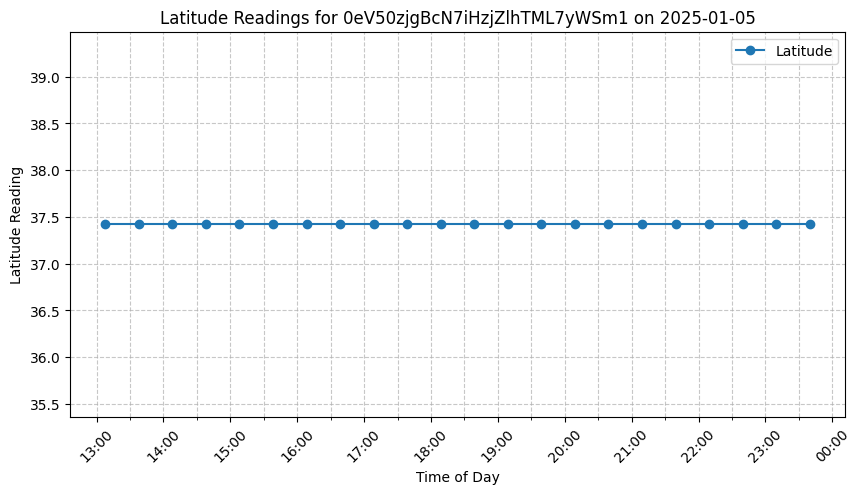

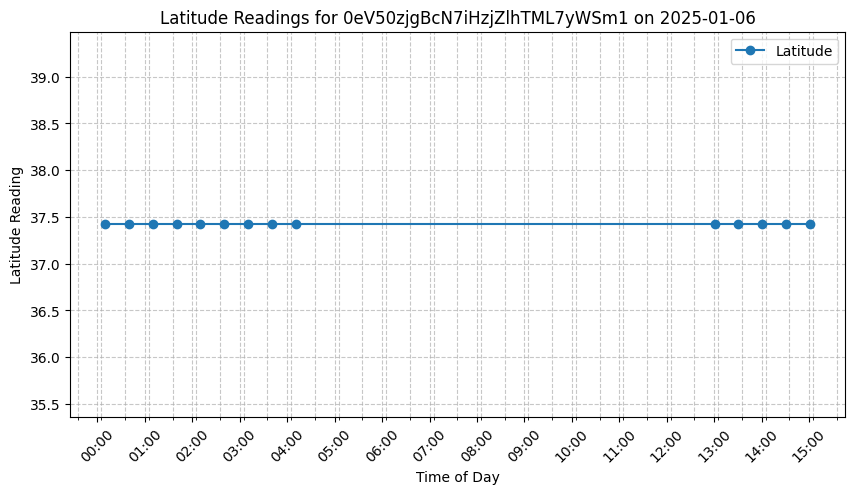

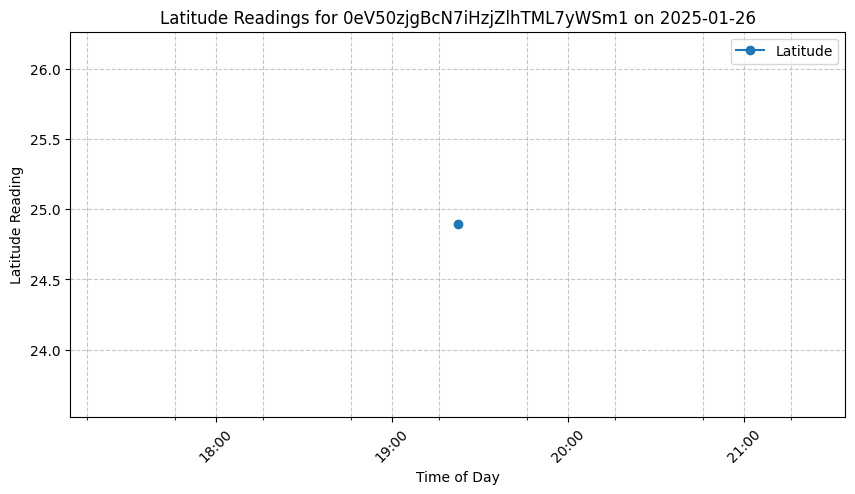

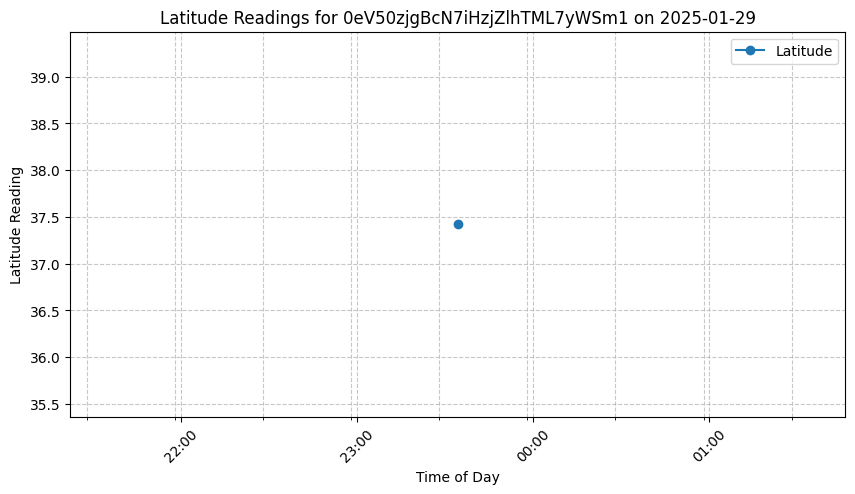

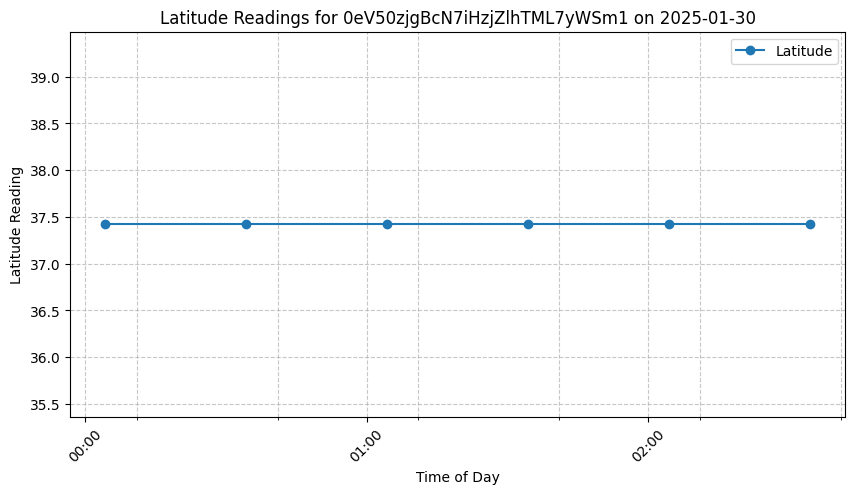

...

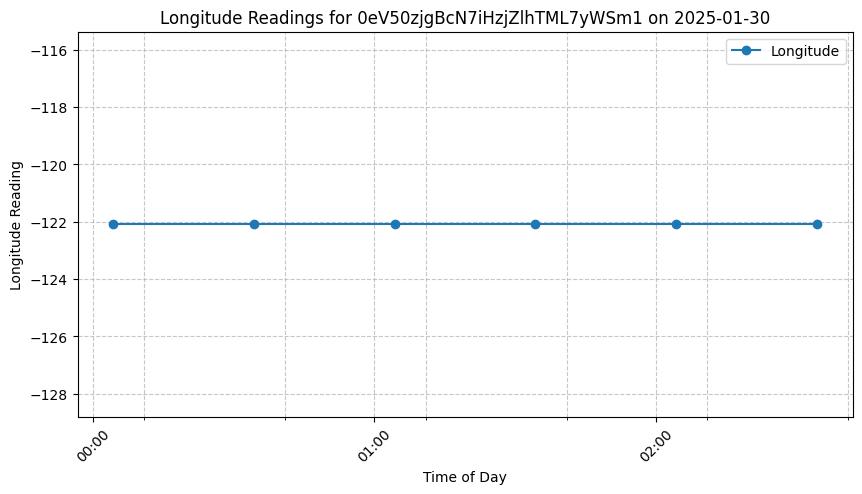

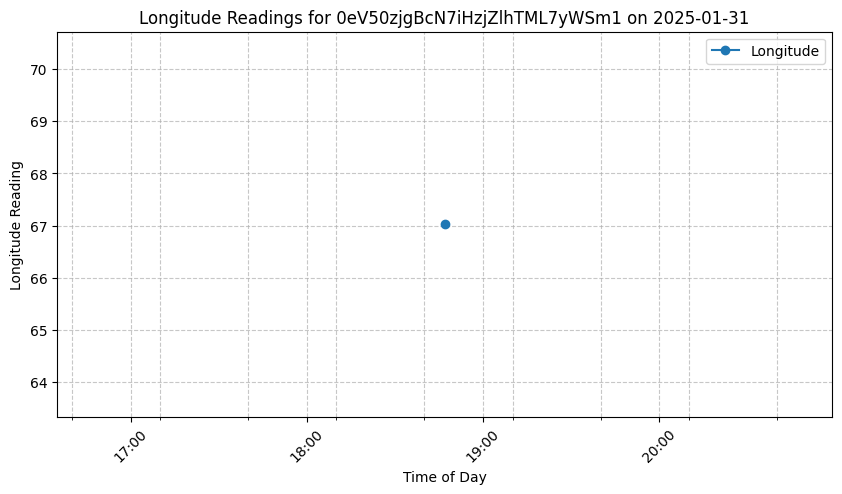

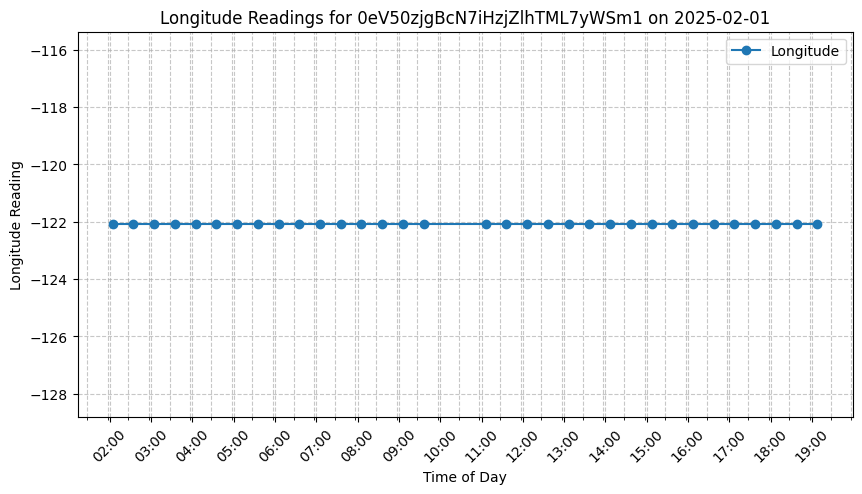

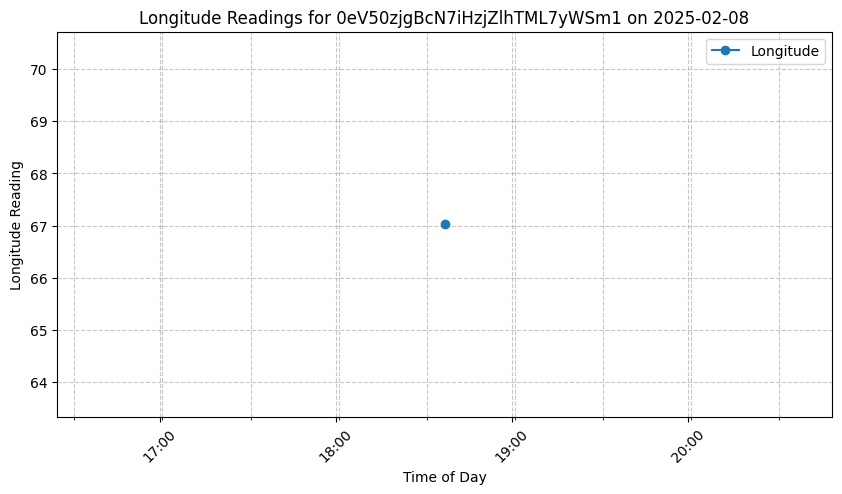

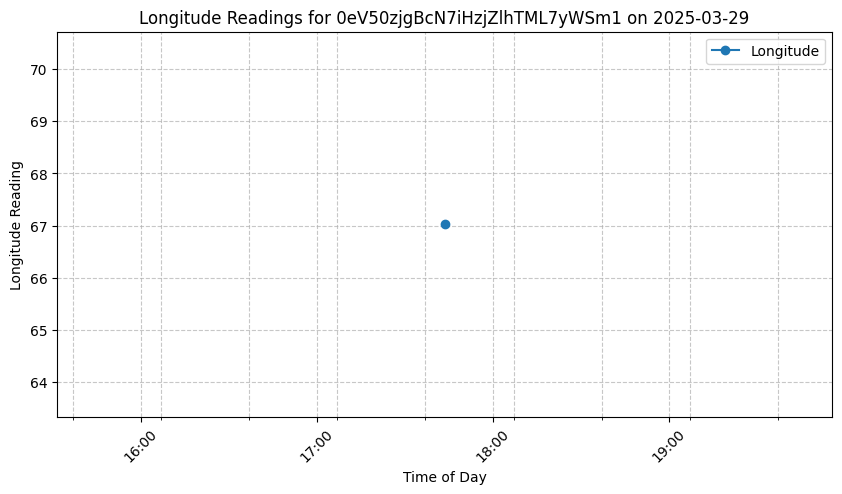

In [9]:
import matplotlib.pyplot as plt
import os
import datetime

def process_user_location(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    lat_timestamps, lat_values = [], []
    long_timestamps, long_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "latitude" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    latitude = sensor_data["latitude"]
                    if isinstance(timestamp, int):
                        lat_timestamps.append(timestamp)
                        lat_values.append(latitude)
                    elif isinstance(timestamp, list) and isinstance(latitude, list):
                        lat_timestamps.extend(timestamp)
                        lat_values.extend(latitude)
                
                if "longitude" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    longitude = sensor_data["longitude"]
                    if isinstance(timestamp, int):
                        long_timestamps.append(timestamp)
                        long_values.append(longitude)
                    elif isinstance(timestamp, list) and isinstance(longitude, list):
                        long_timestamps.extend(timestamp)
                        long_values.extend(longitude)

    # Ensure sorting maintains correct values
    lat_sorted = sorted(zip(lat_timestamps, lat_values)) if lat_timestamps else []
    long_sorted = sorted(zip(long_timestamps, long_values)) if long_timestamps else []

    lat_timestamps, lat_values = zip(*lat_sorted) if lat_sorted else ([], [])
    long_timestamps, long_values = zip(*long_sorted) if long_sorted else ([], [])

    return lat_timestamps, lat_values, long_timestamps, long_values

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def plot_daily_readings(user_id, timestamps, values, label):
    if not timestamps:
        print(f"ℹ No {label} readings available for user {user_id}.")
        return
    
    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "location_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label=label)
        plt.xlabel("Time of Day")
        plt.ylabel(f"{label} Reading")
        plt.title(f"{label} Readings for {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)
        
        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_{label.lower()}_{date}.png"))
        plt.show()

# Example Usage:
user_id = "0eV50zjgBcN7iHzjZlhTML7yWSm1"  # Replace with the actual user ID
lat_timestamps, lat_values, long_timestamps, long_values = process_user_location(user_id, data)

plot_daily_readings(user_id, lat_timestamps, lat_values, "Latitude")
plot_daily_readings(user_id, long_timestamps, long_values, "Longitude")


# Brightness plots for 0eV50zjgBcN7iHzjZlhTML7yWSm1

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "0eV50zjgBcN7iHzjZlhTML7yWSm1"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)


# Brightness plot for 60nbTTrkaNZrqOBocU03j6Jl1Zq2


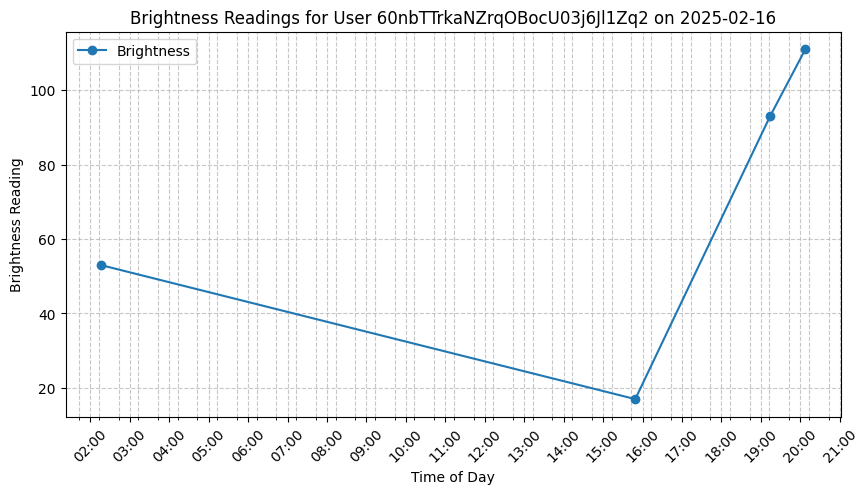

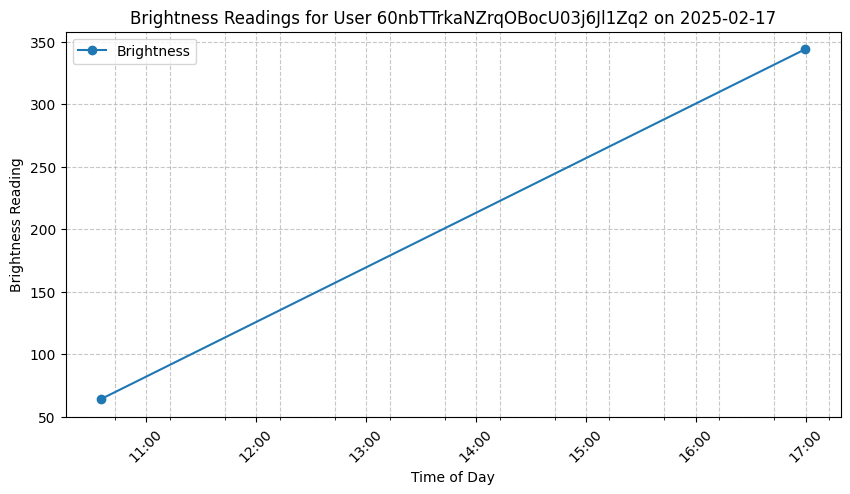

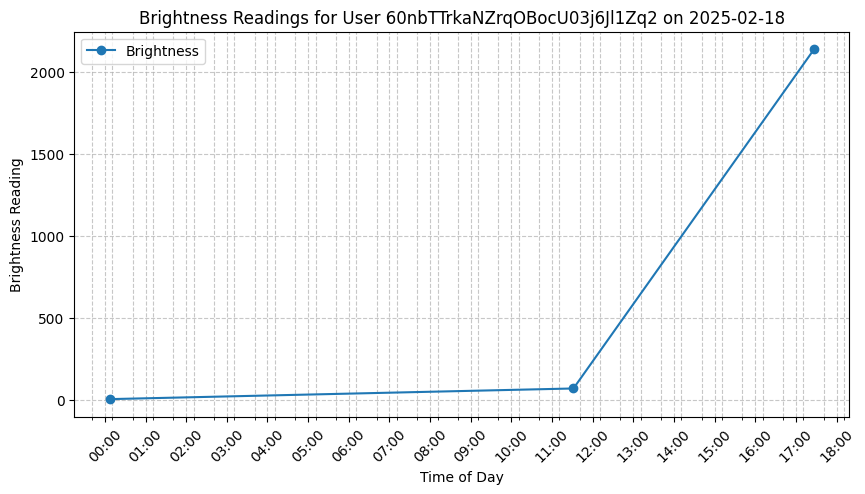

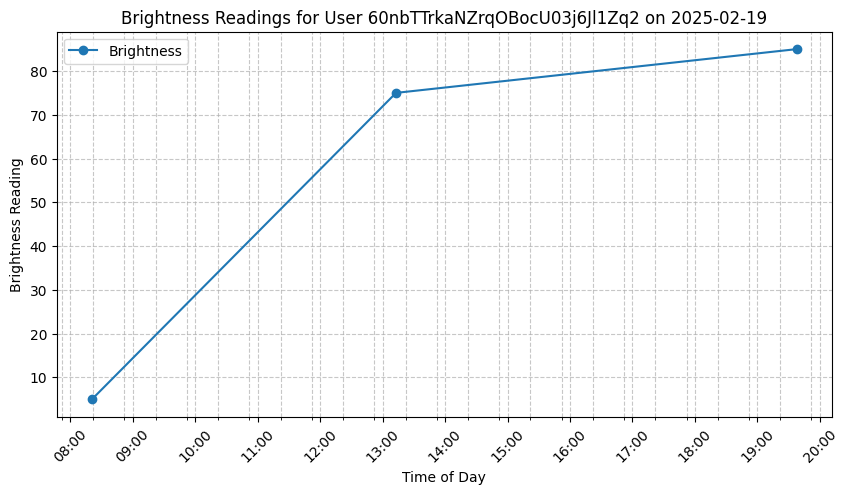

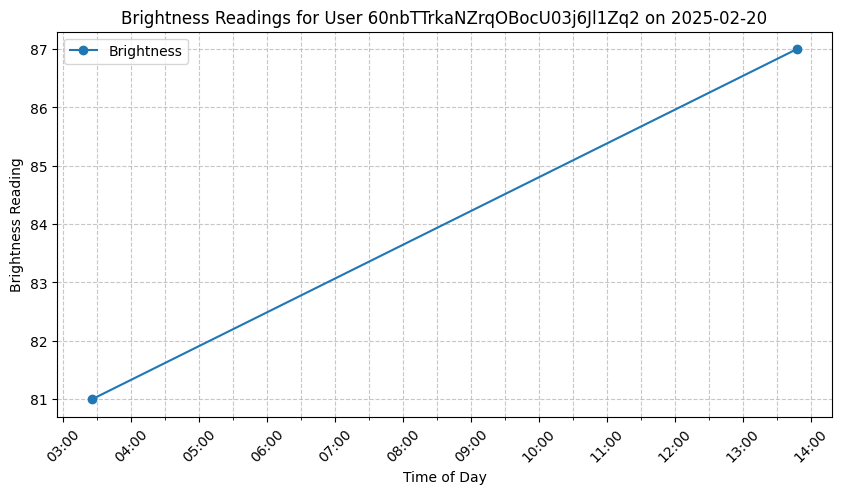

...

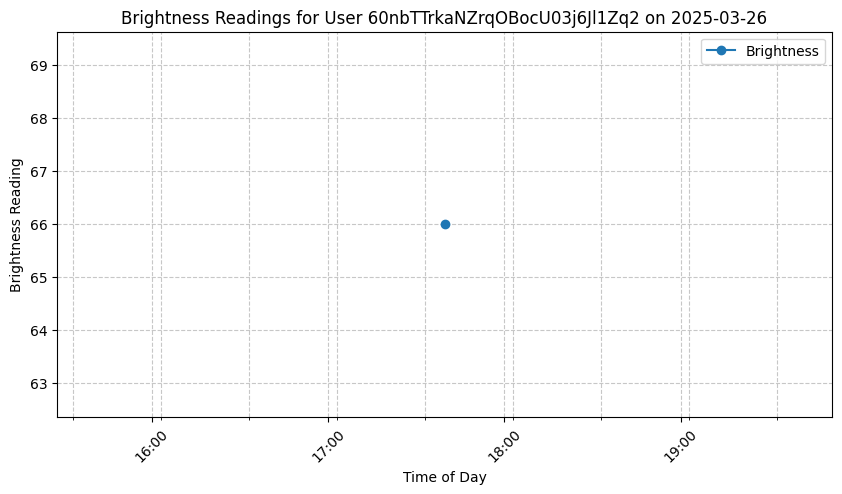

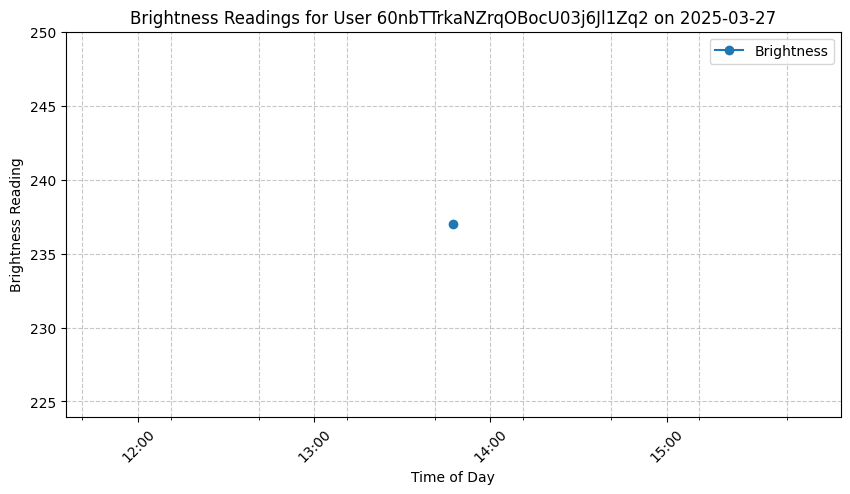

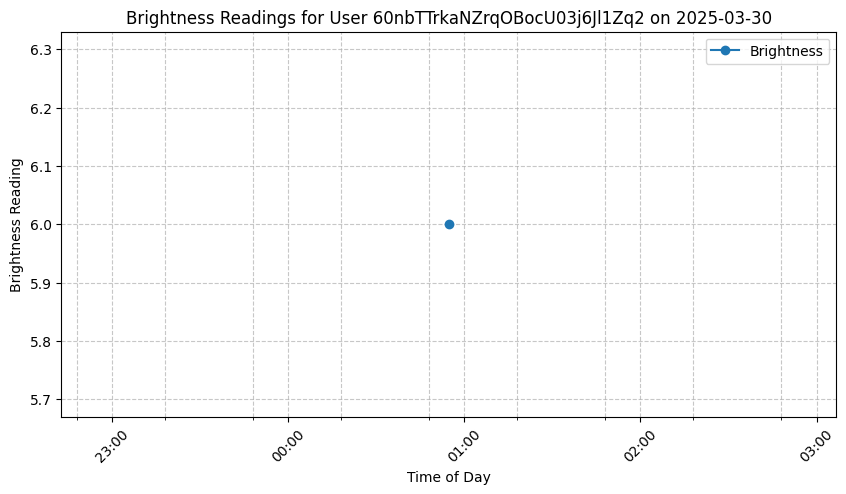

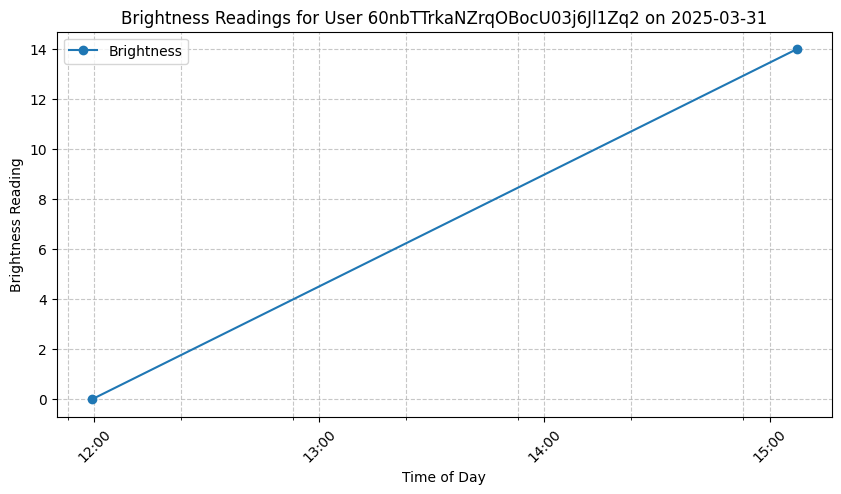

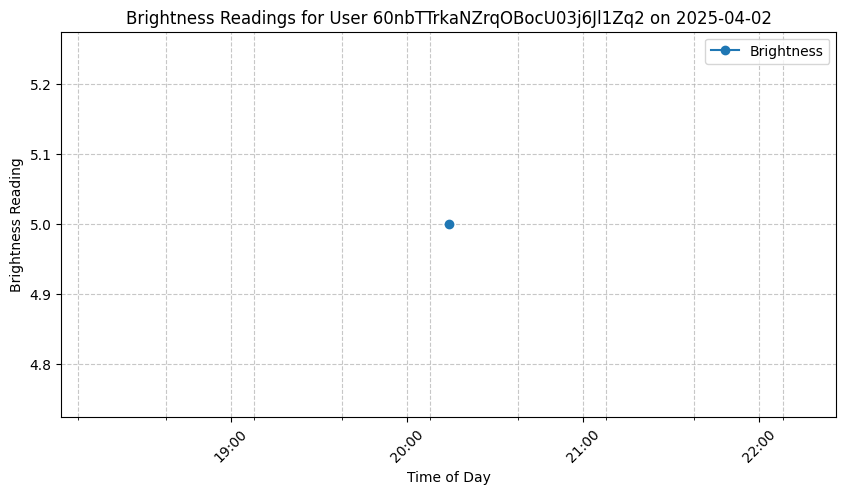

In [11]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "60nbTTrkaNZrqOBocU03j6Jl1Zq2"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)


# Brightness plots for Qm9YlAxAdRMKDCyDePxaj2rgx3k1

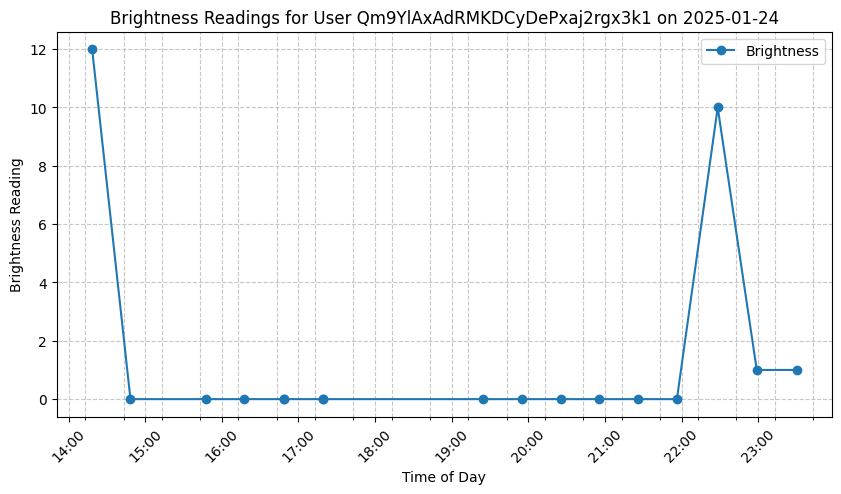

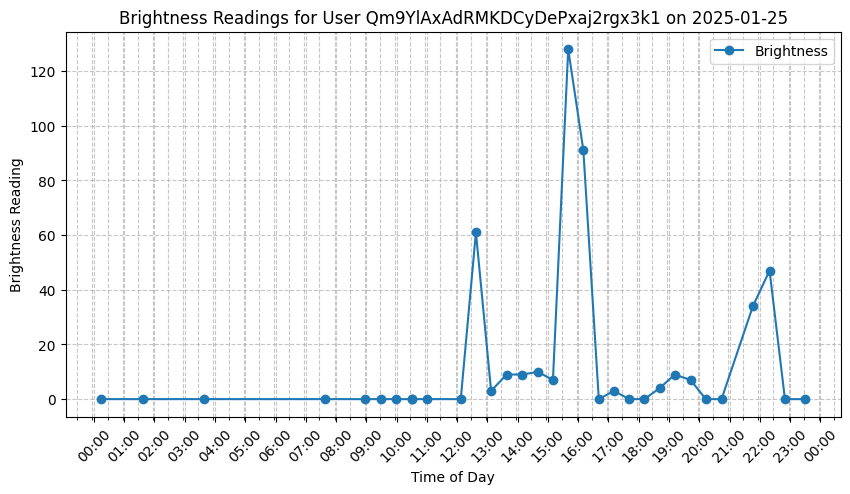

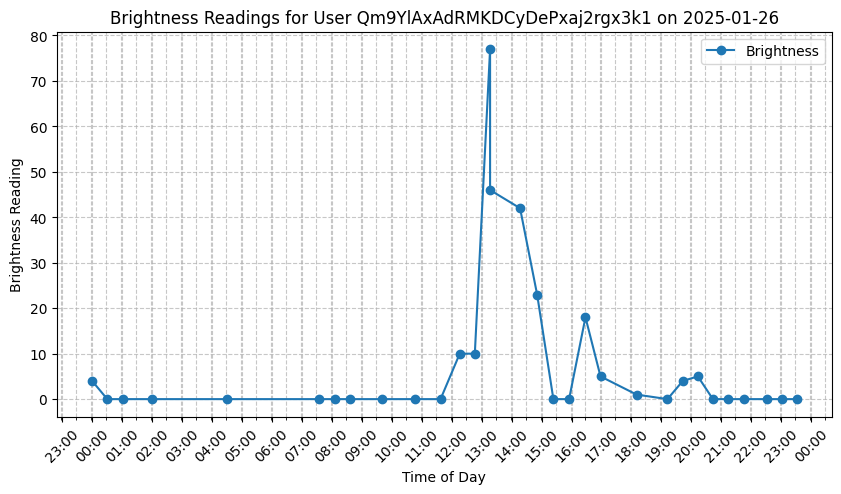

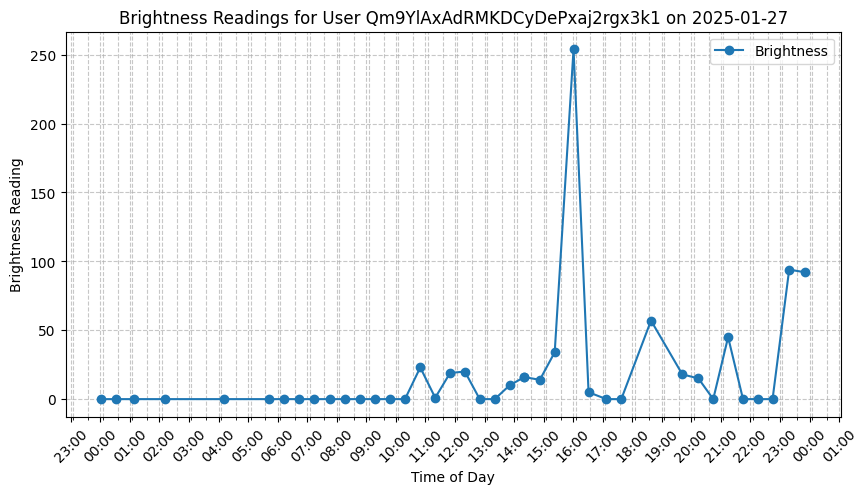

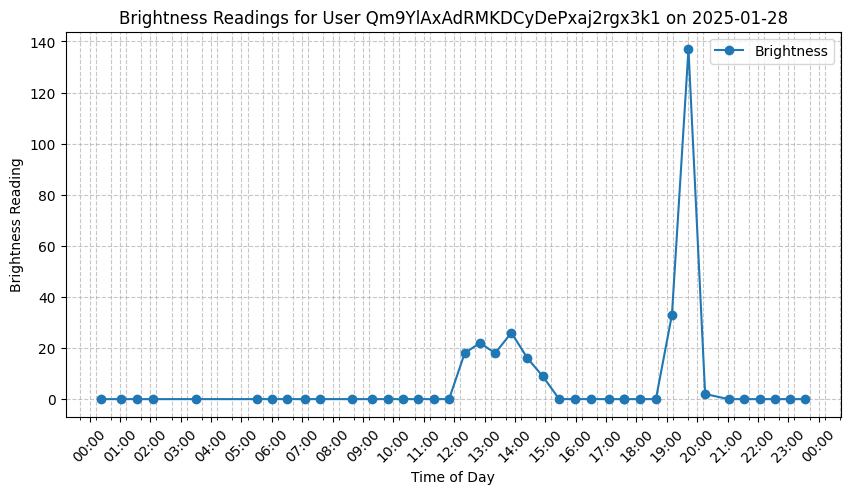

...

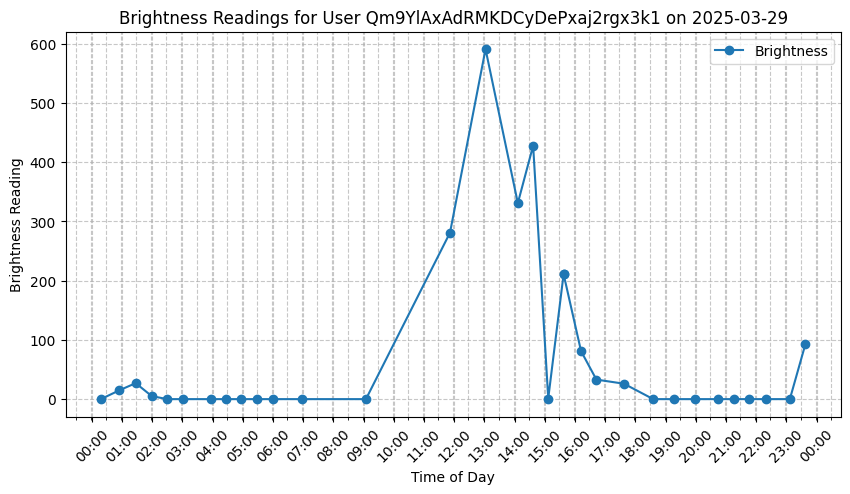

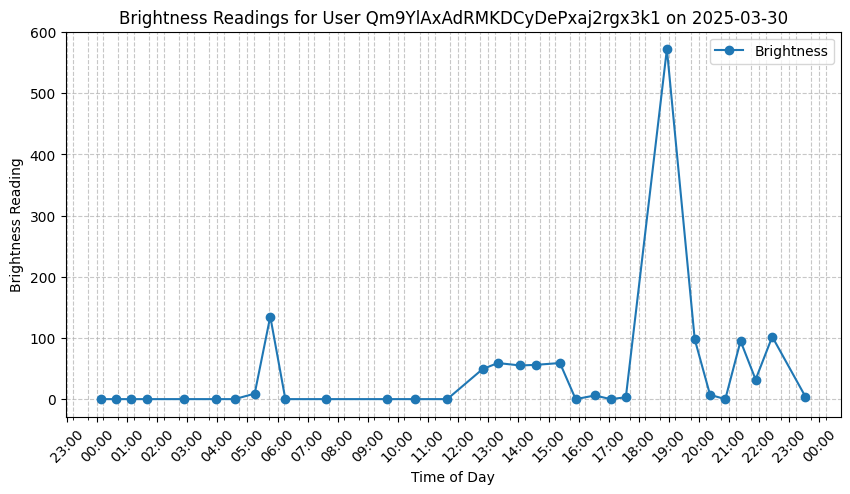

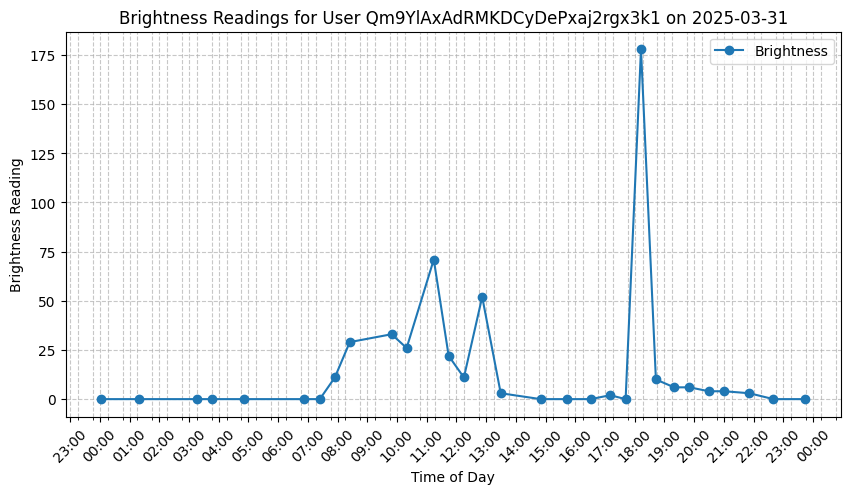

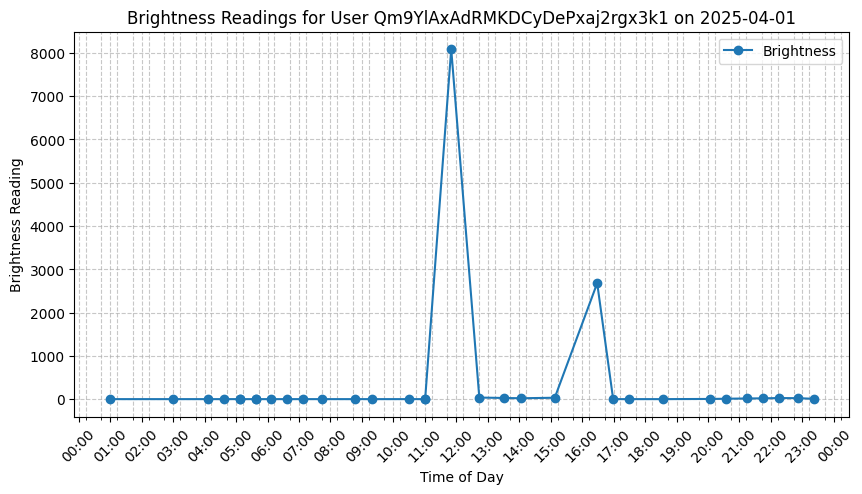

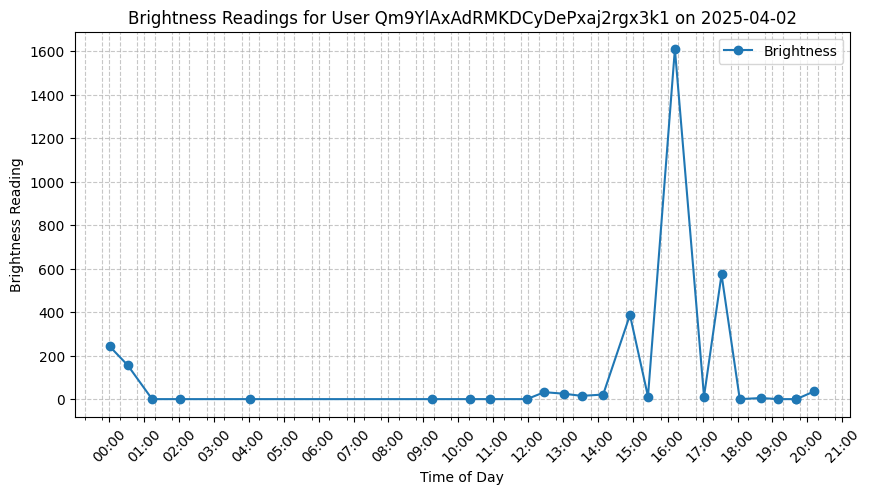

In [12]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "Qm9YlAxAdRMKDCyDePxaj2rgx3k1"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)

# Brightness plots for TroIjiUCjsdtCrXpE4MsXxHS68h2

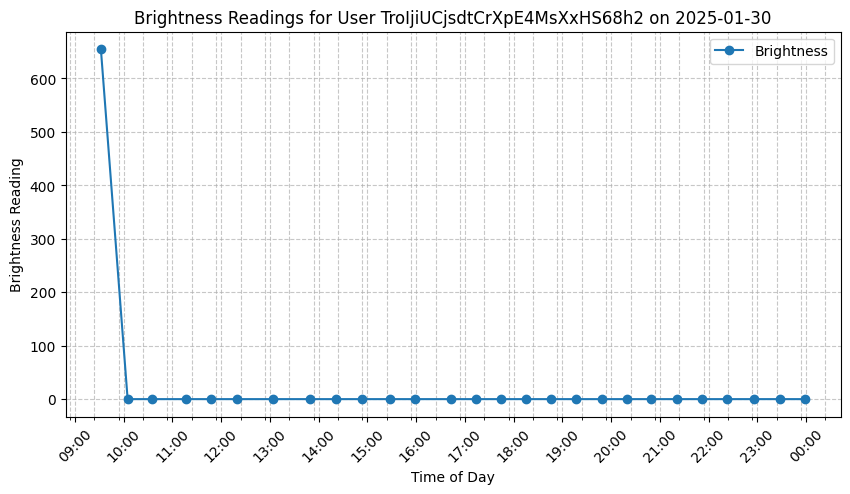

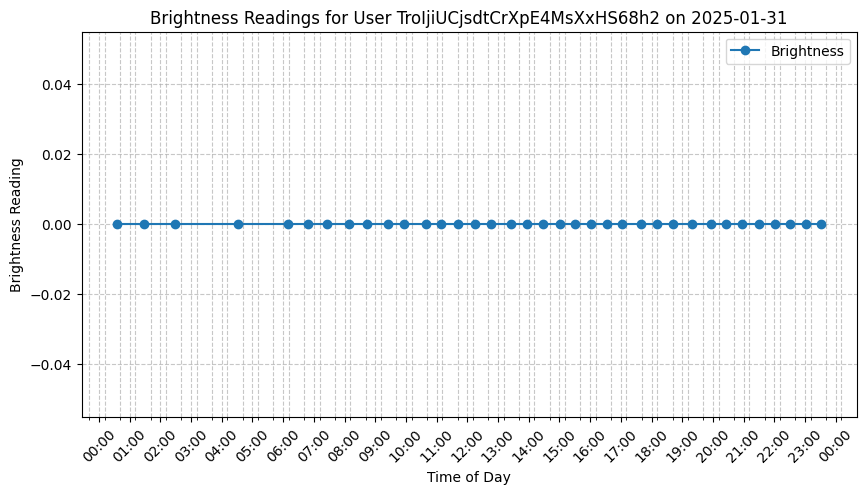

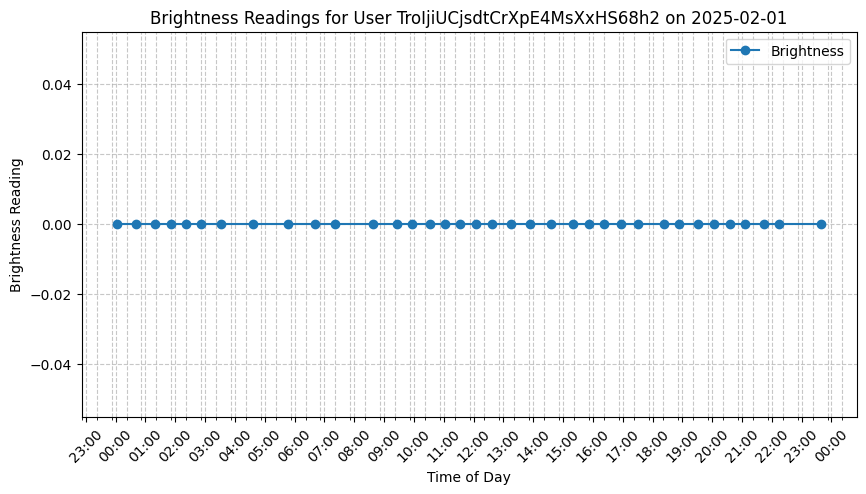

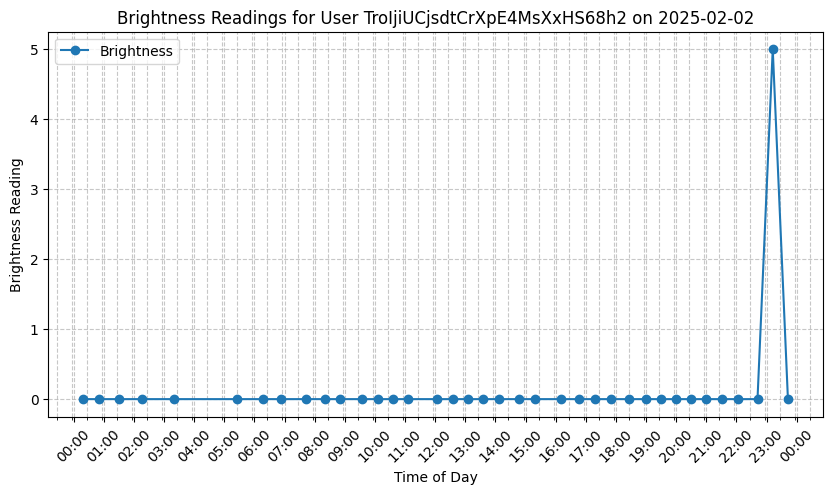

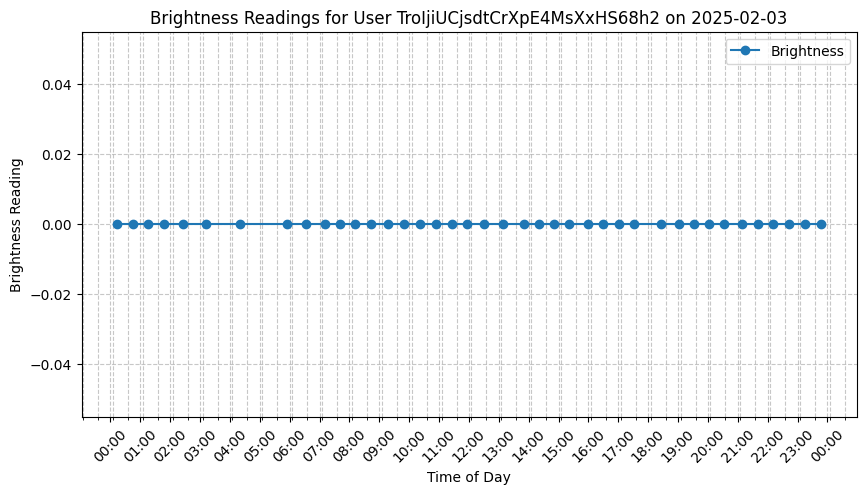

...

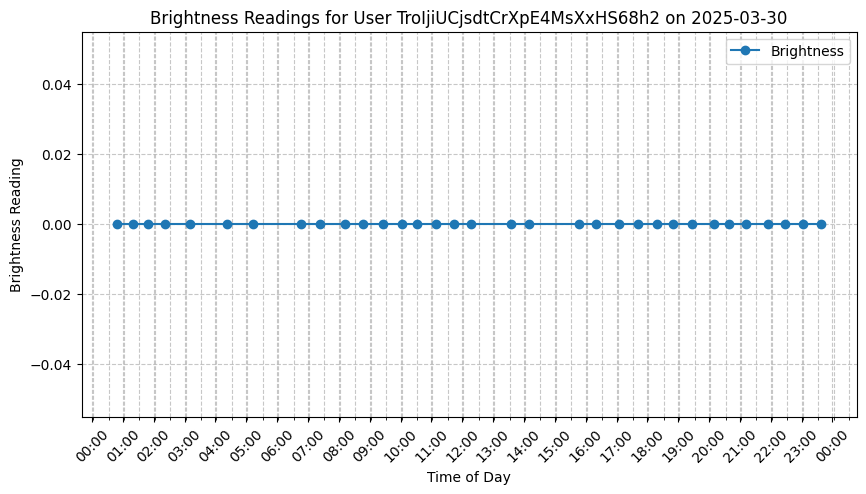

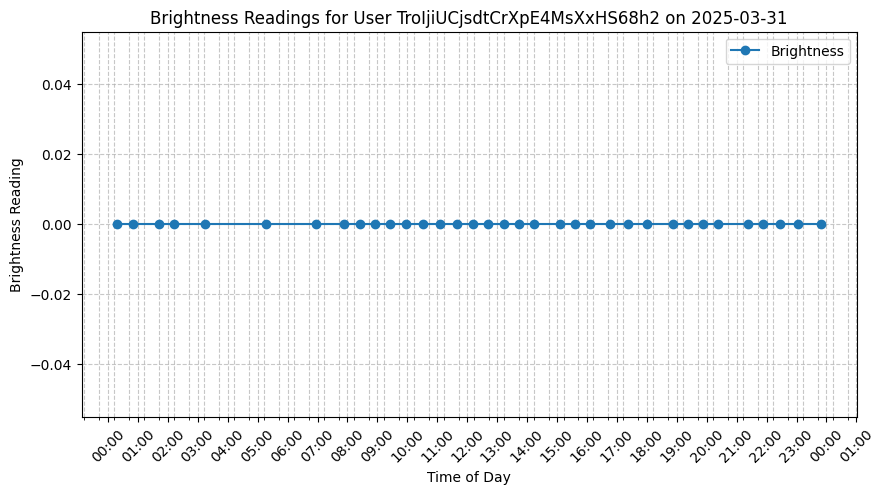

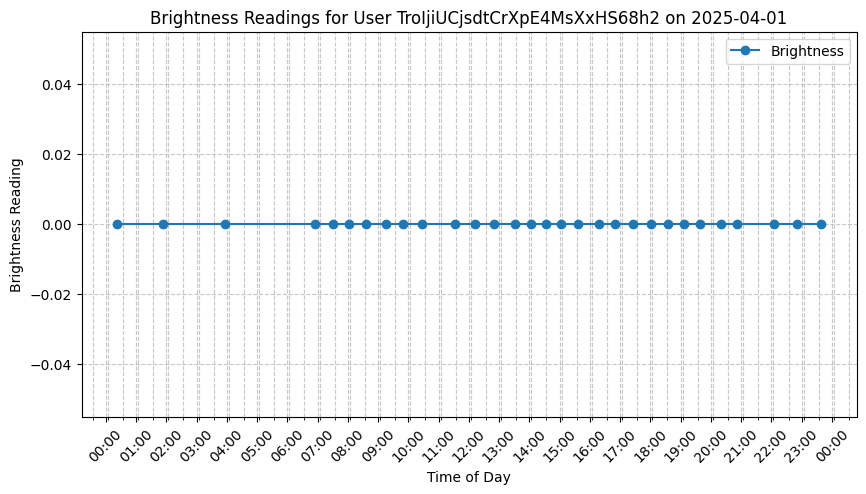

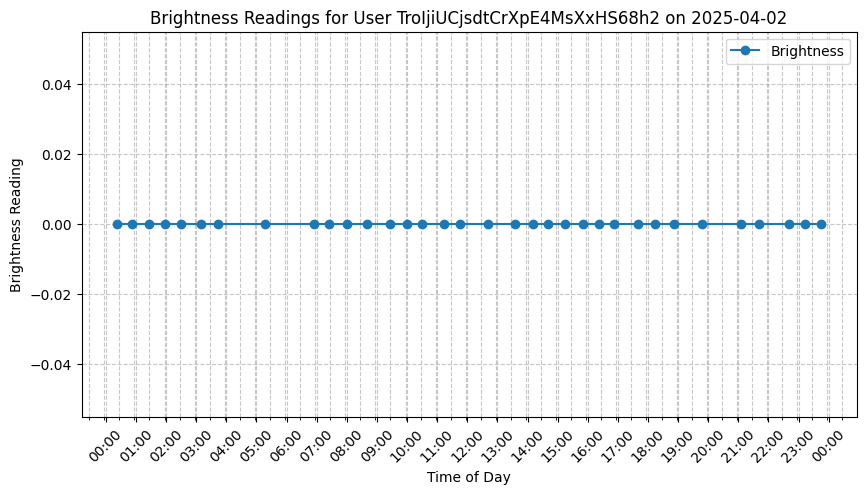

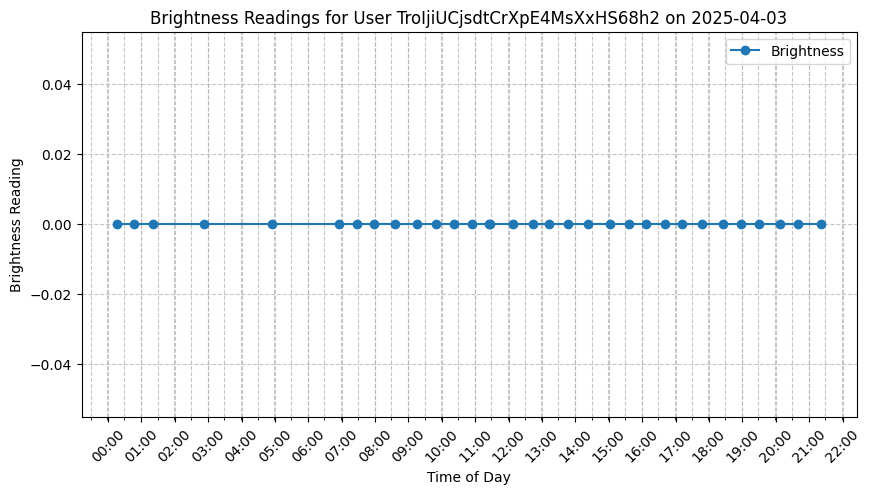

In [13]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "TroIjiUCjsdtCrXpE4MsXxHS68h2"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)

# Brightness plot for YwkUJbOPNIfm4NEcYDIvnF67vNv2

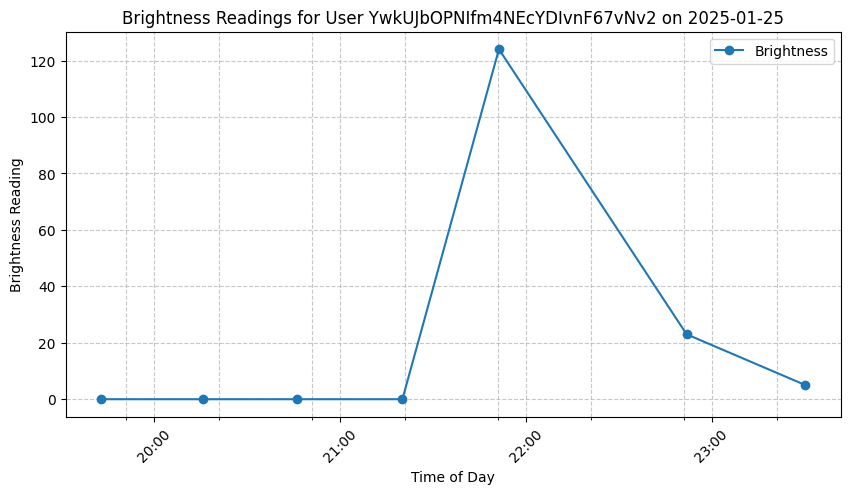

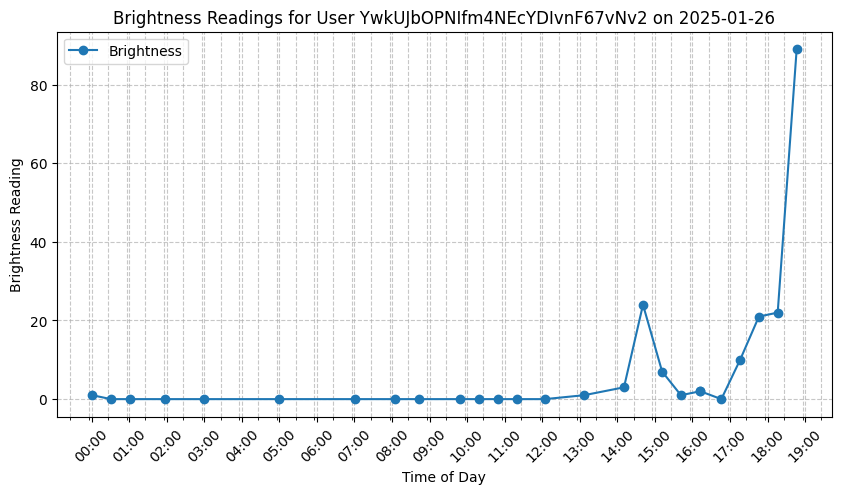

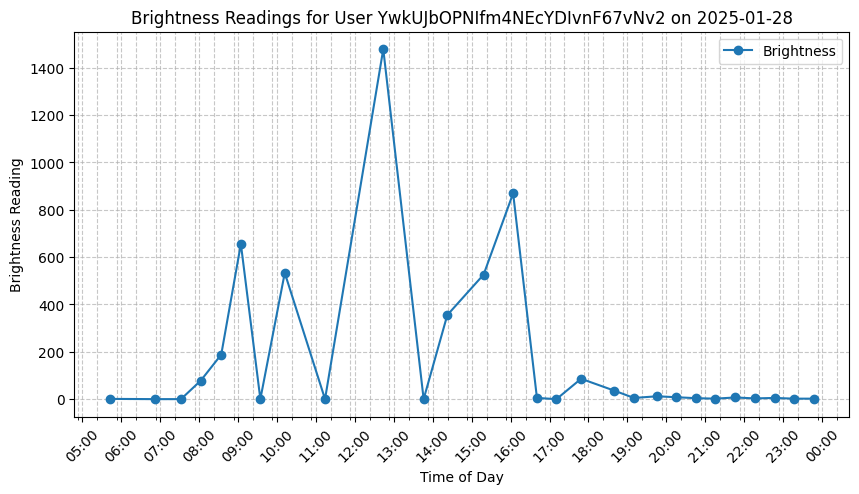

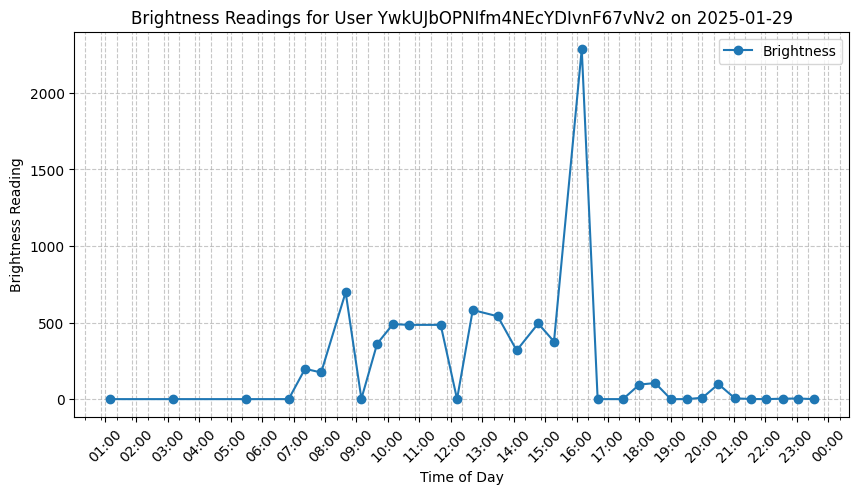

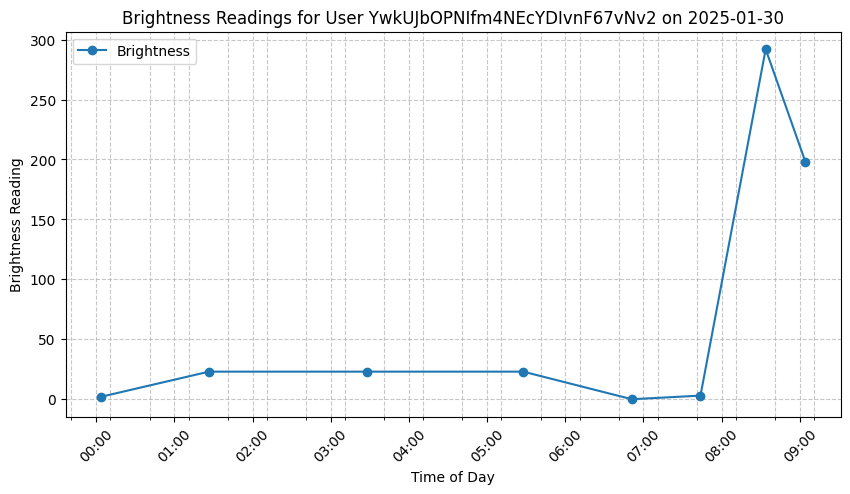

...

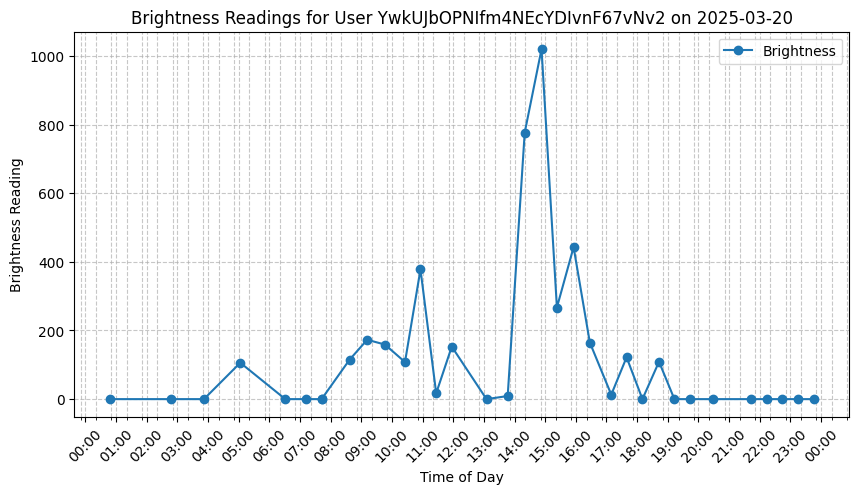

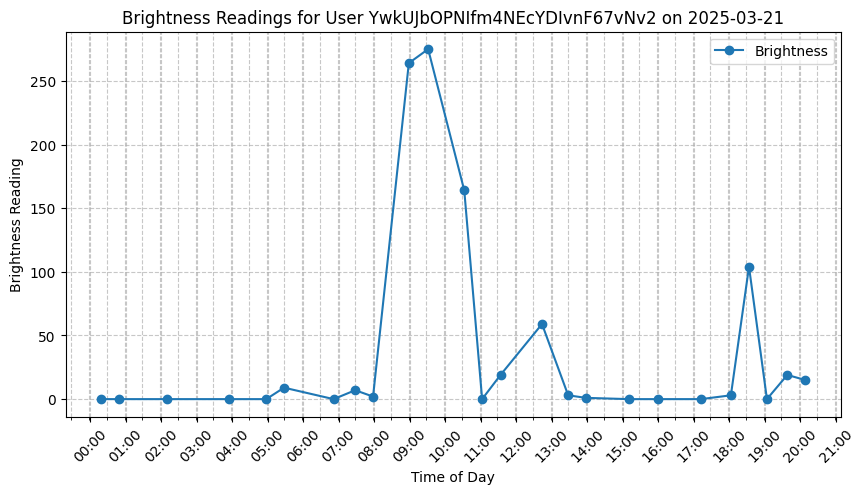

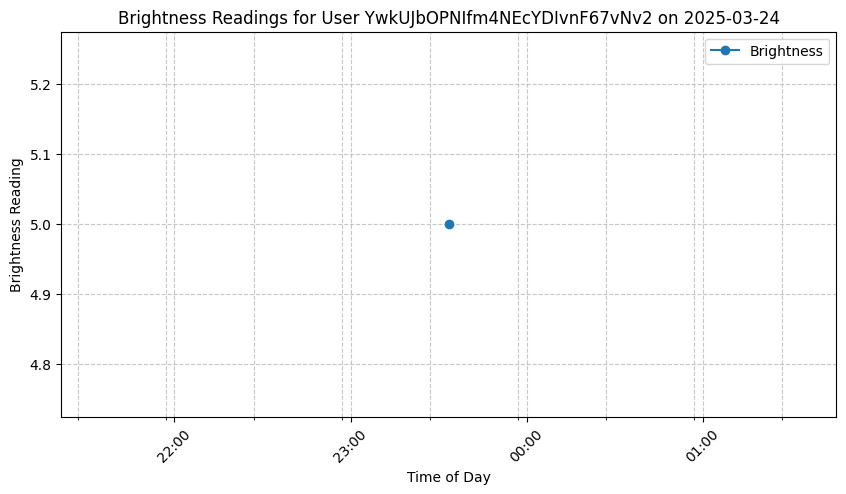

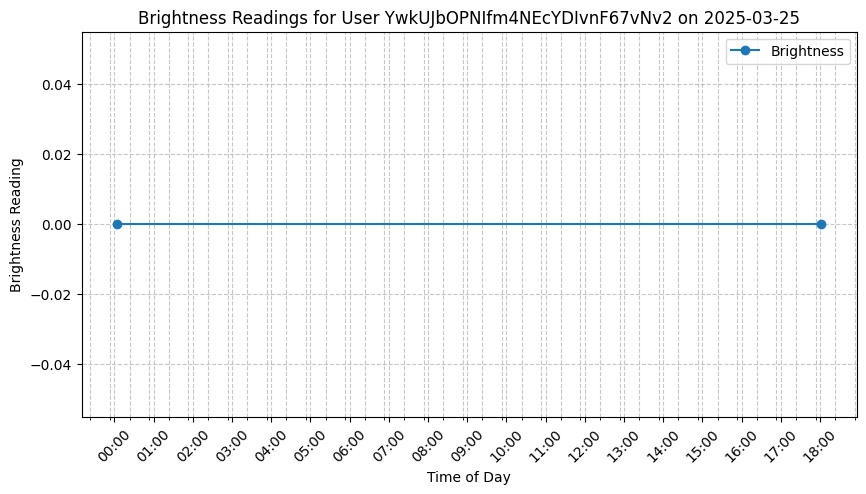

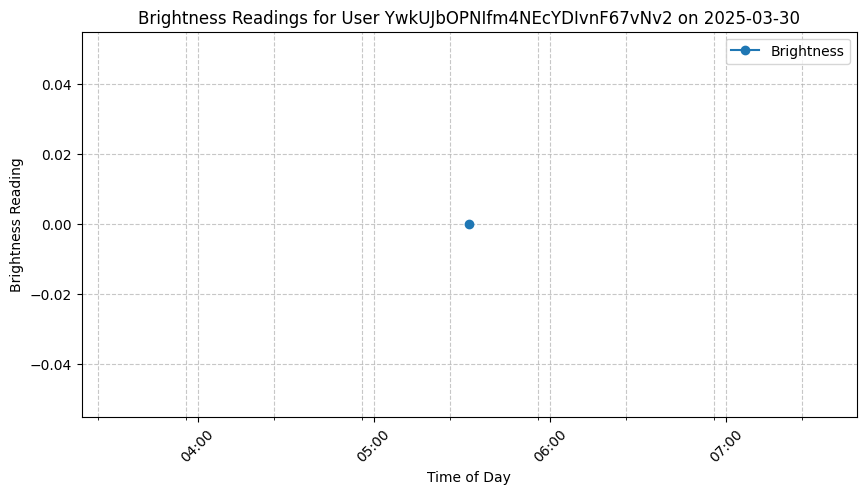

In [14]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "YwkUJbOPNIfm4NEcYDIvnF67vNv2"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)

# Brightness plots for fJZyTzEnJiau0FCHMST8msu1XqE2

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "fJZyTzEnJiau0FCHMST8msu1XqE2"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)

# Brightness plots for t8p0YeBANpeO8OK1ZMkukoopiz82


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "t8p0YeBANpeO8OK1ZMkukoopiz82"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)

# Brightness plots for zLgCd28bDmfsj5fdr3W02sOFv0H3

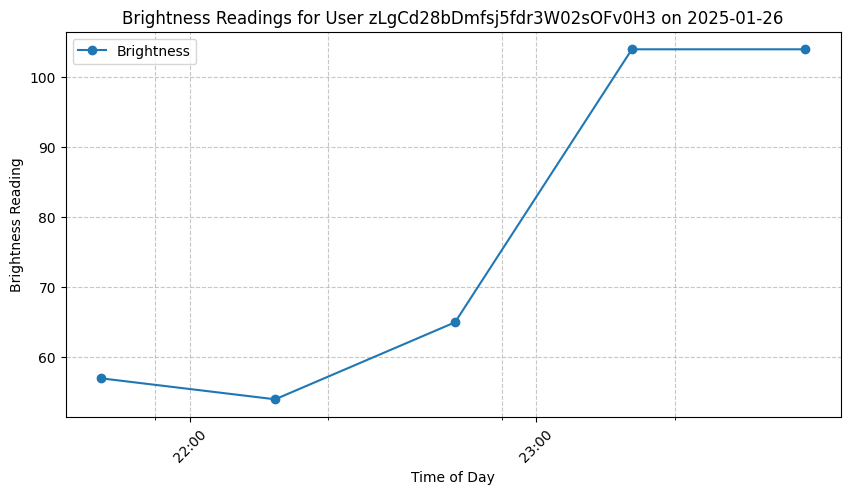

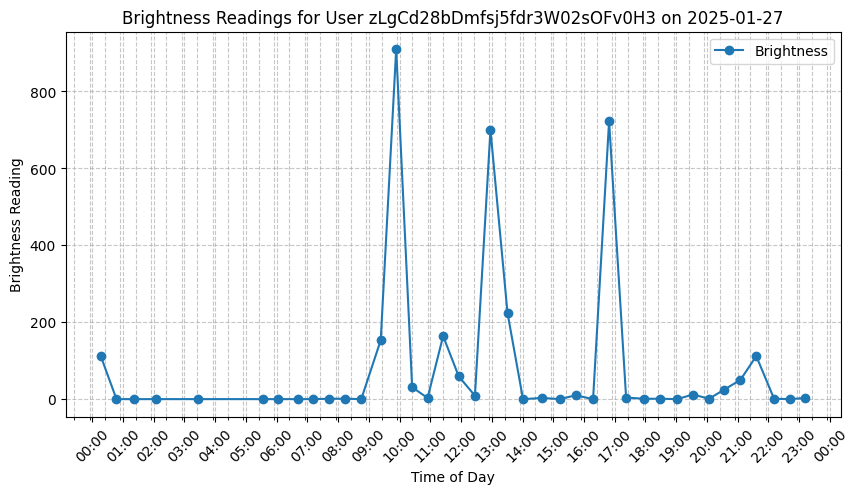

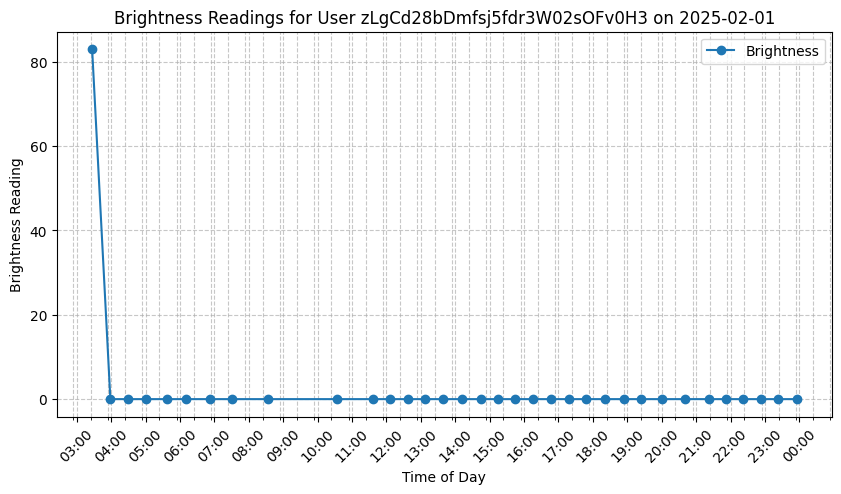

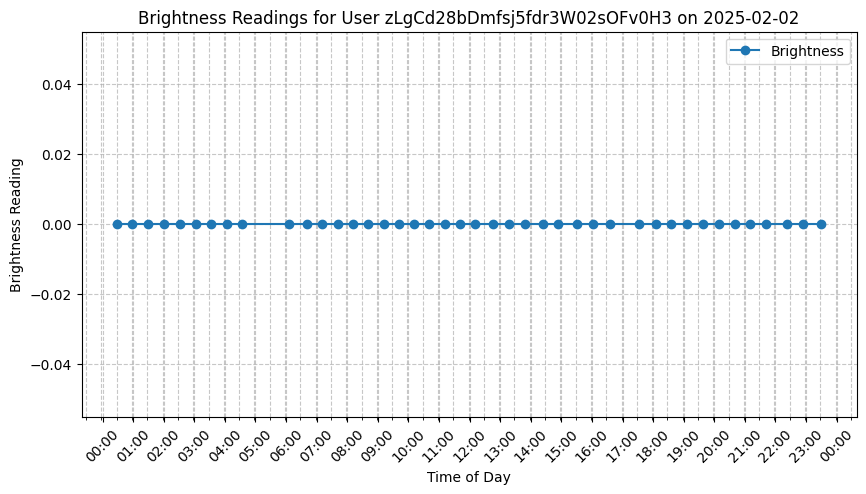

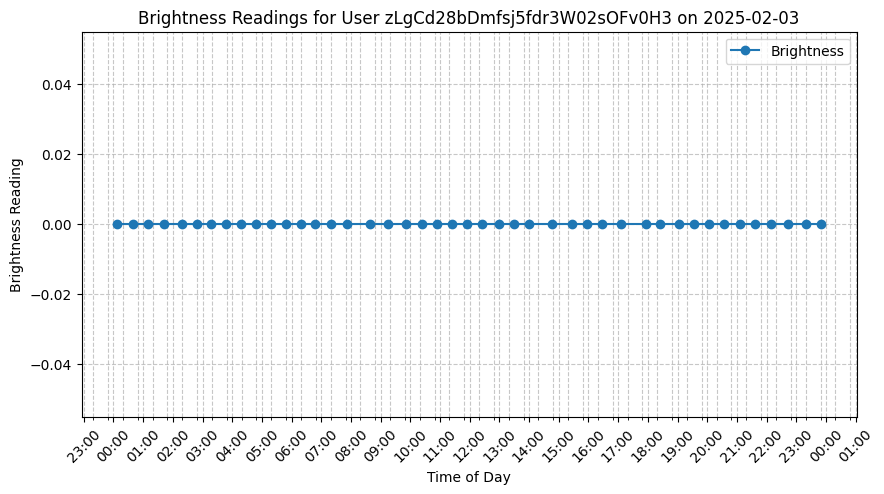

...

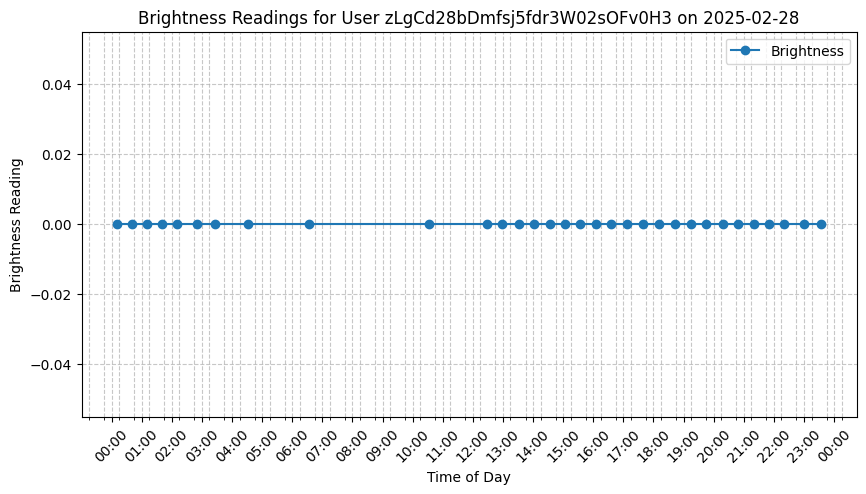

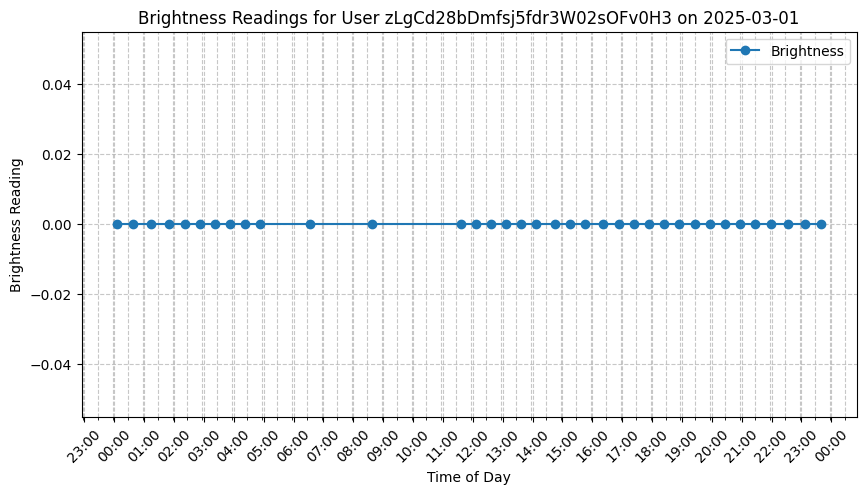

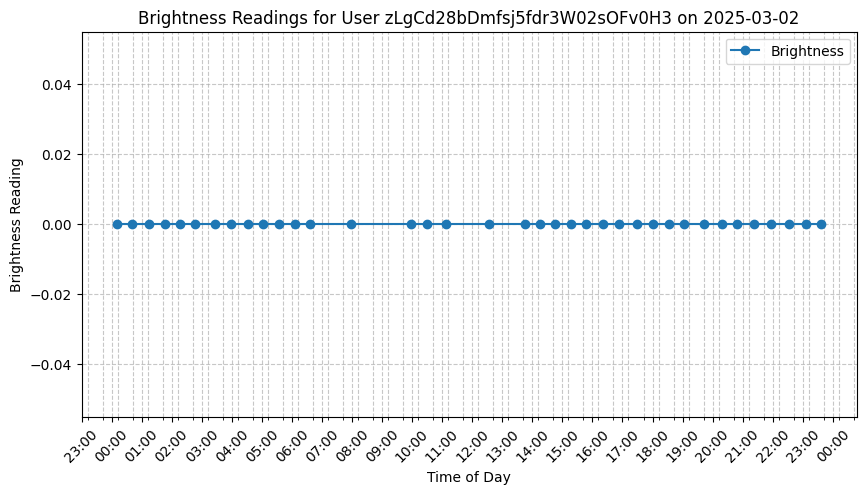

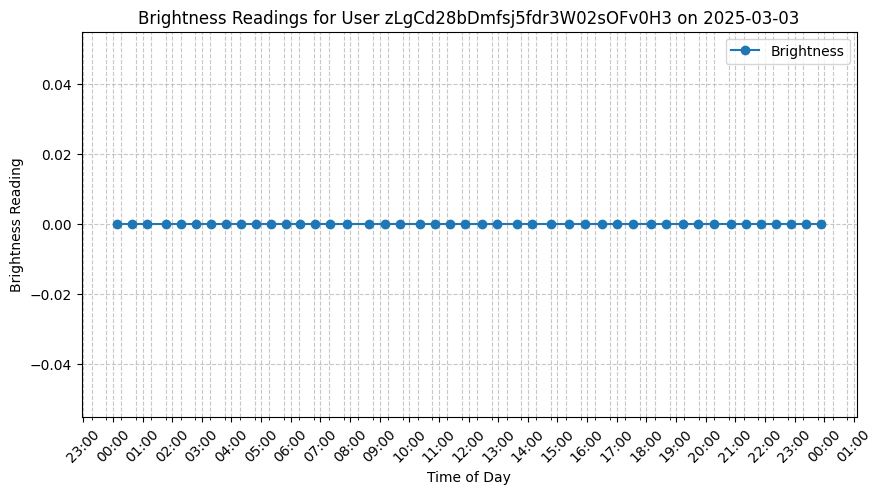

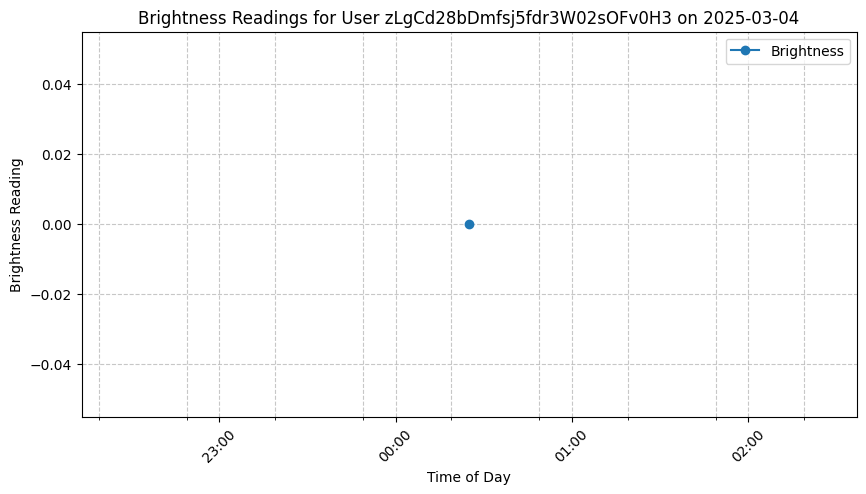

In [17]:


import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_brightness(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    brightness_timestamps, brightness_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "luminance" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    brightness = sensor_data["luminance"]
                    if isinstance(timestamp, int):
                        brightness_timestamps.append(timestamp)
                        brightness_values.append(brightness)
                    elif isinstance(timestamp, list) and isinstance(brightness, list):
                        brightness_timestamps.extend(timestamp)
                        brightness_values.extend(brightness)

    # Ensure sorting maintains correct values
    brightness_sorted = sorted(zip(brightness_timestamps, brightness_values)) if brightness_timestamps else []
    brightness_timestamps, brightness_values = zip(*brightness_sorted) if brightness_sorted else ([], [])

    return brightness_timestamps, brightness_values

def plot_daily_brightness(user_id, timestamps, values):
    if not timestamps:
        print(f"ℹ No brightness readings available for user {user_id}.")
        return

    # Convert timestamps from milliseconds to datetime objects
    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    # Group data by date
    daily_data = {}
    for t, v in zip(timestamps, values):
        date_str = t.strftime("%Y-%m-%d")
        if date_str not in daily_data:
            daily_data[date_str] = ([], [])
        daily_data[date_str][0].append(t)
        daily_data[date_str][1].append(v)

    # Create output directory
    output_dir = "brightness_plots"
    os.makedirs(output_dir, exist_ok=True)

    for date, (times, readings) in daily_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label="Brightness")
        plt.xlabel("Time of Day")
        plt.ylabel("Brightness Reading")
        plt.title(f"Brightness Readings for User {user_id} on {date}")

        # Format the x-axis for time of day
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))   # Major ticks every hour
        plt.gca().xaxis.set_minor_locator(mdates.MinuteLocator(interval=30)) # Minor ticks every 30 minutes
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%H:%M"))  # Show time as HH:MM
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_brightness_{date}.png"))
        plt.show()

# Example Usage:
user_id = "zLgCd28bDmfsj5fdr3W02sOFv0H3"  # Replace with actual user ID
brightness_timestamps, brightness_values = process_user_brightness(user_id, data)

plot_daily_brightness(user_id, brightness_timestamps, brightness_values)


Processing user: 0eV50zjgBcN7iHzjZlhTML7yWSm1


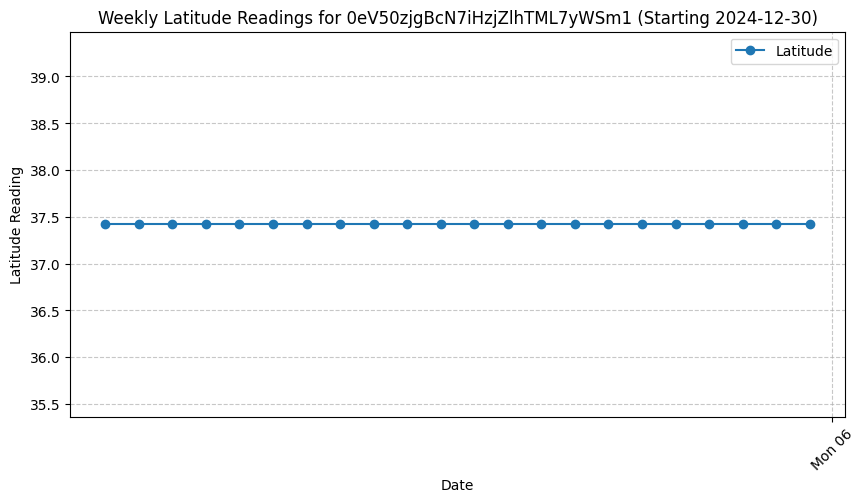

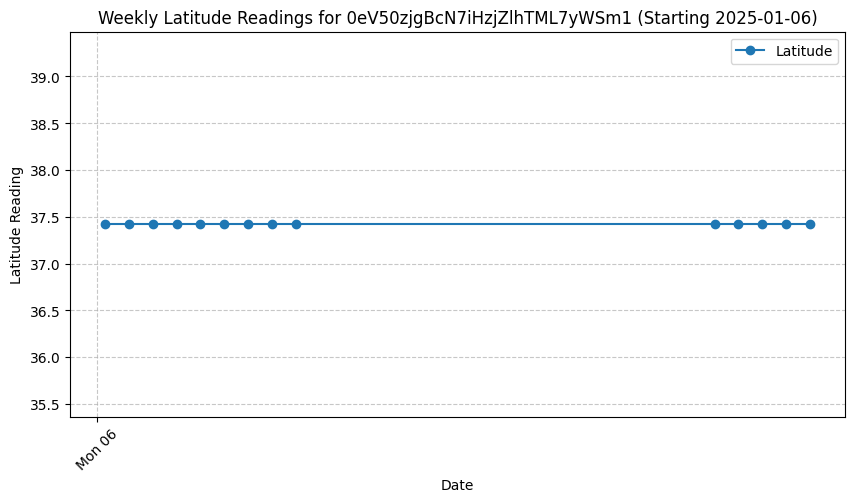

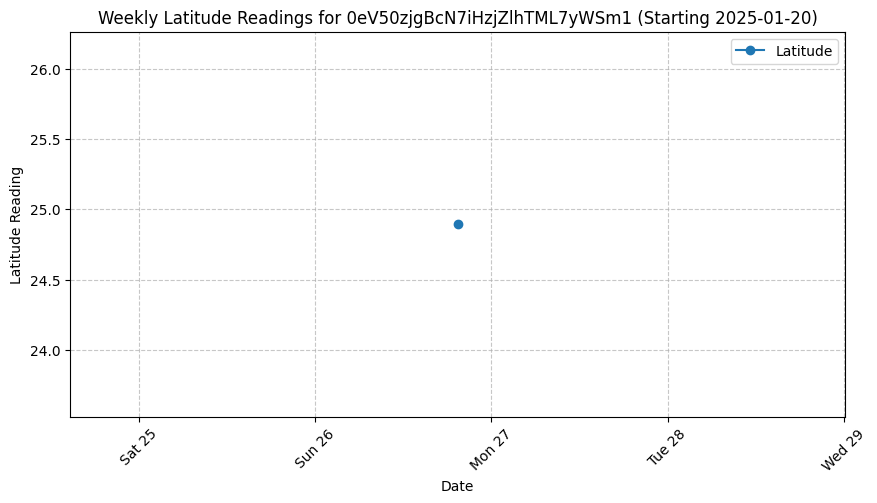

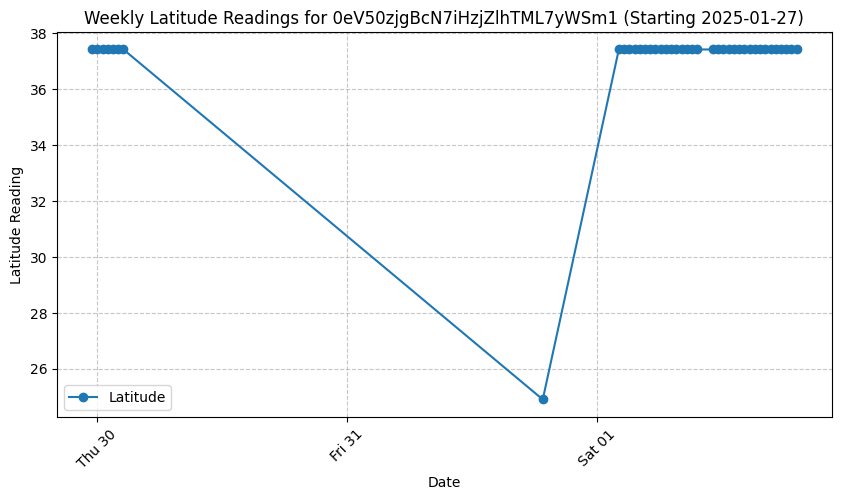

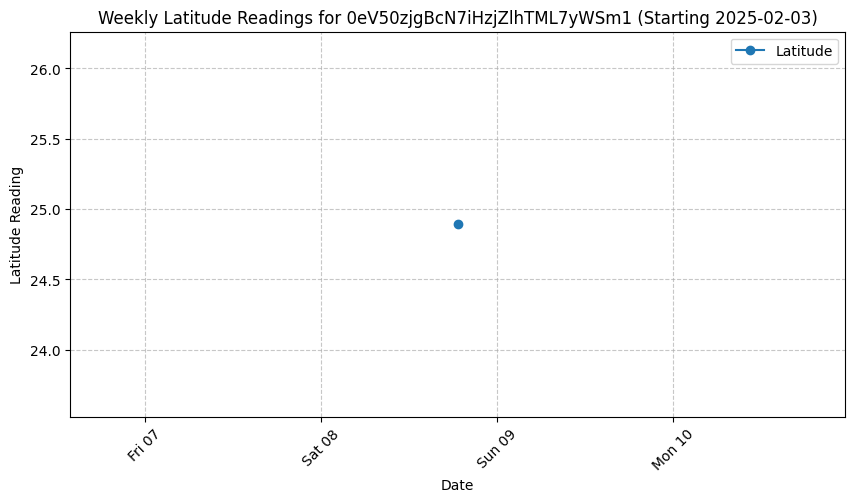

...

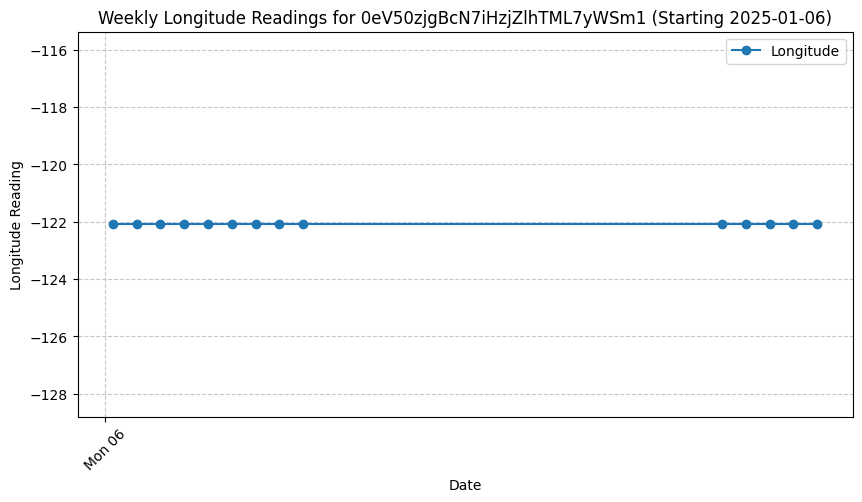

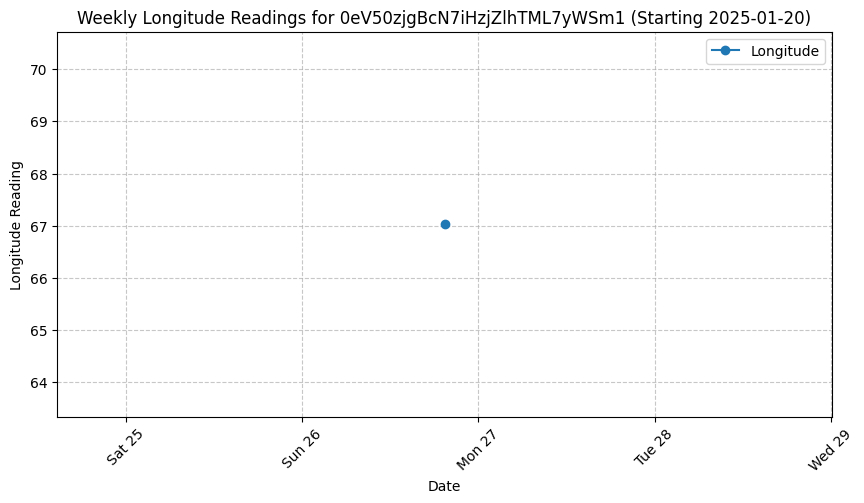

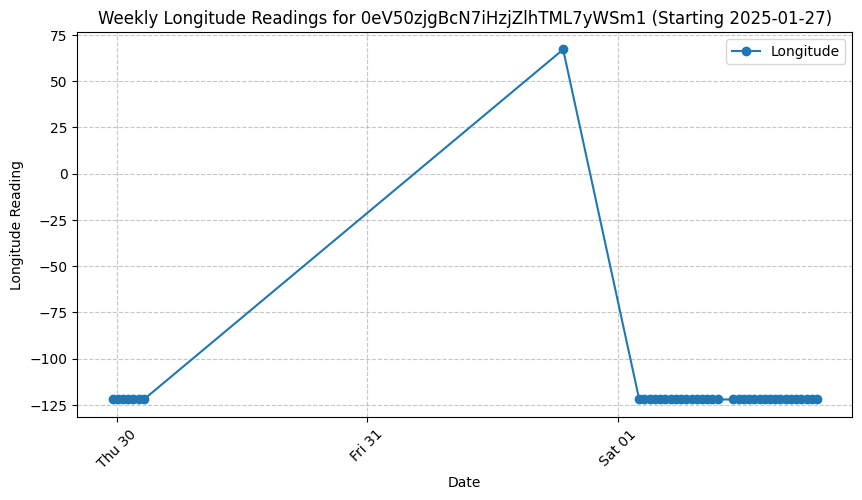

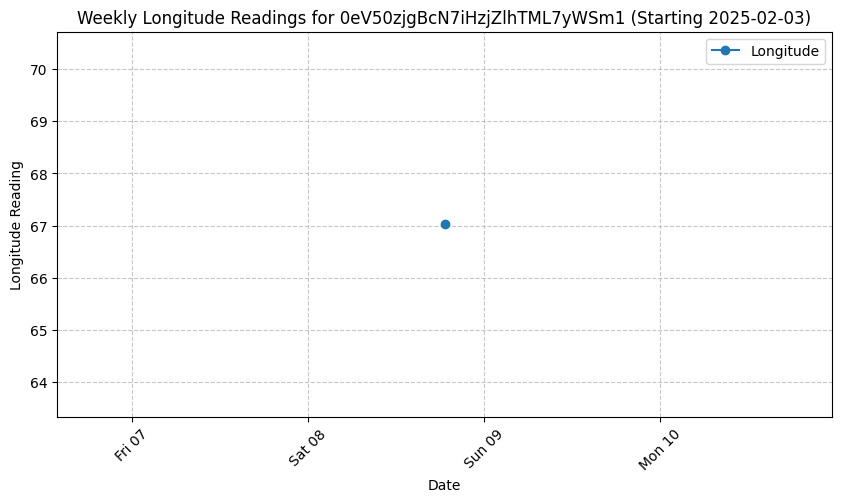

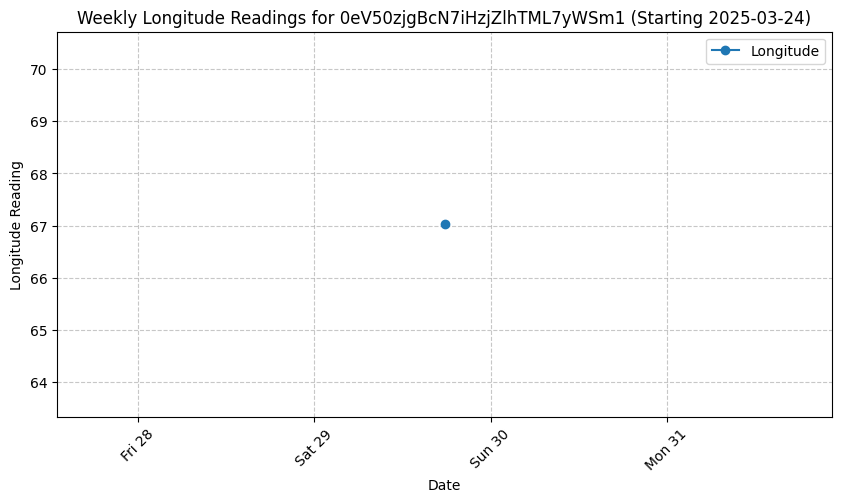


Processing user: 60nbTTrkaNZrqOBocU03j6Jl1Zq2
ℹ No Latitude readings available for user 60nbTTrkaNZrqOBocU03j6Jl1Zq2.
ℹ No Longitude readings available for user 60nbTTrkaNZrqOBocU03j6Jl1Zq2.

Processing user: ELxHa881bEPiJ6w3HUWLfVP0ZxC3


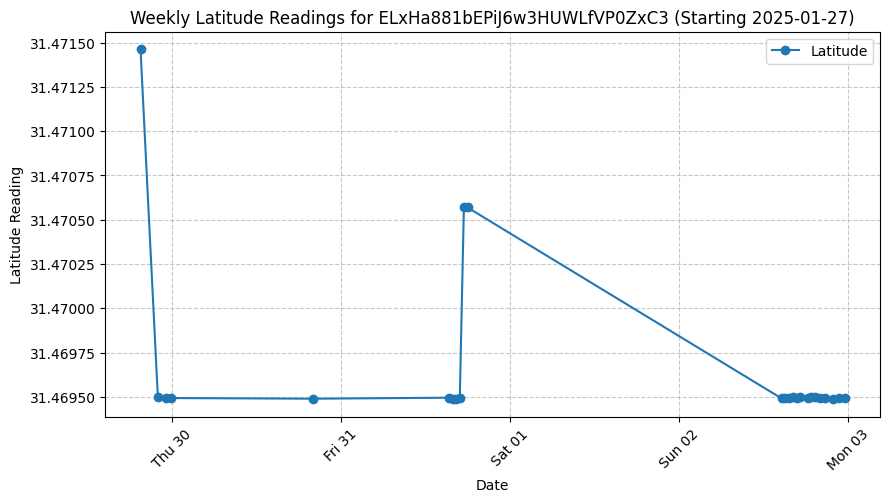

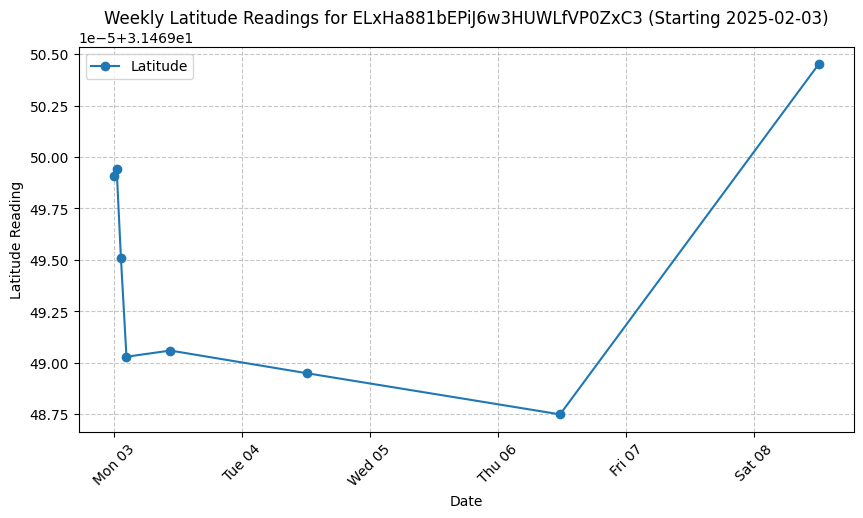

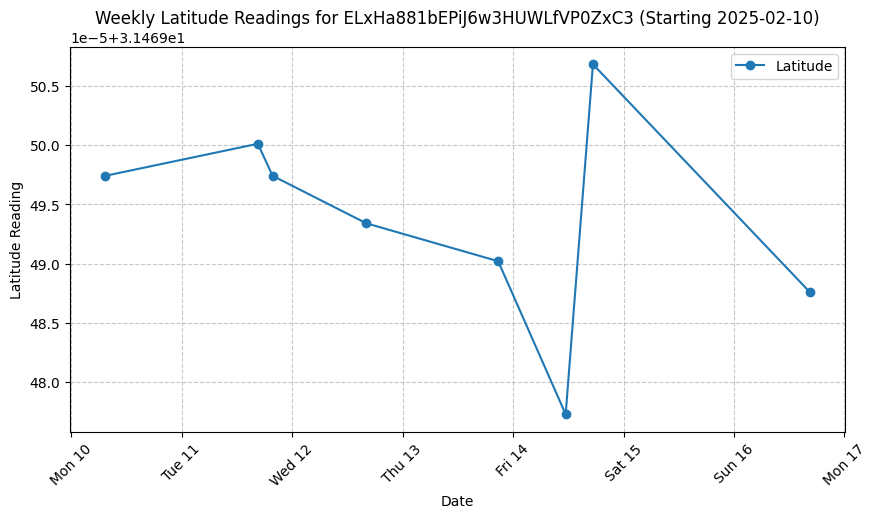

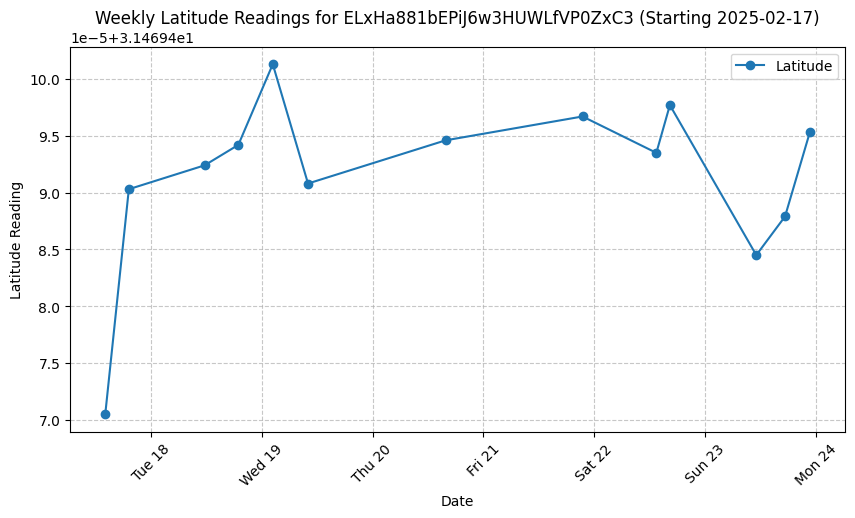

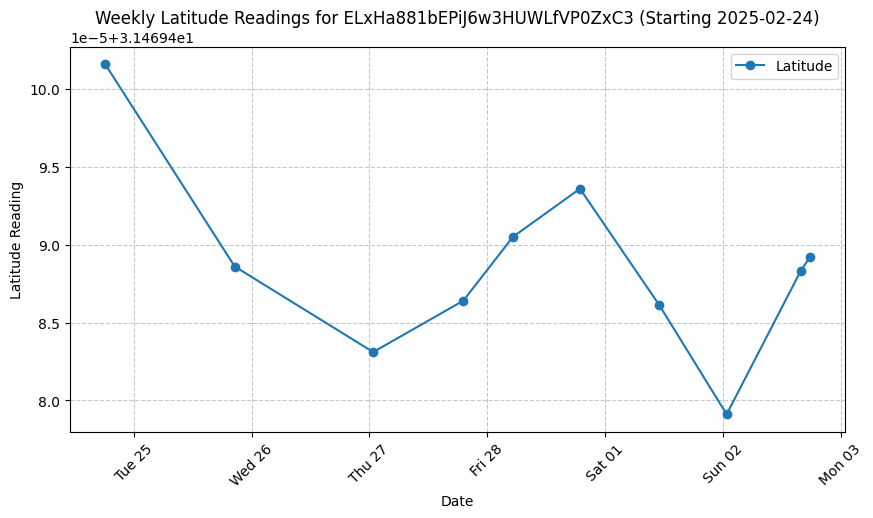

...

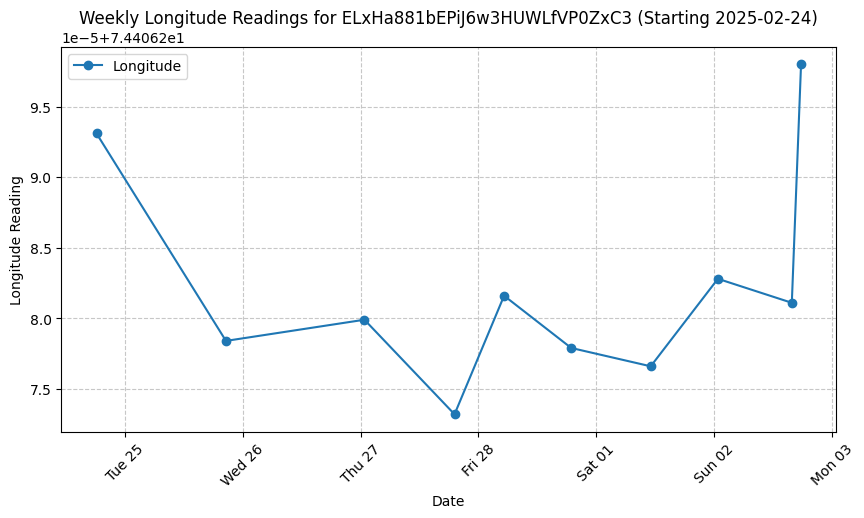

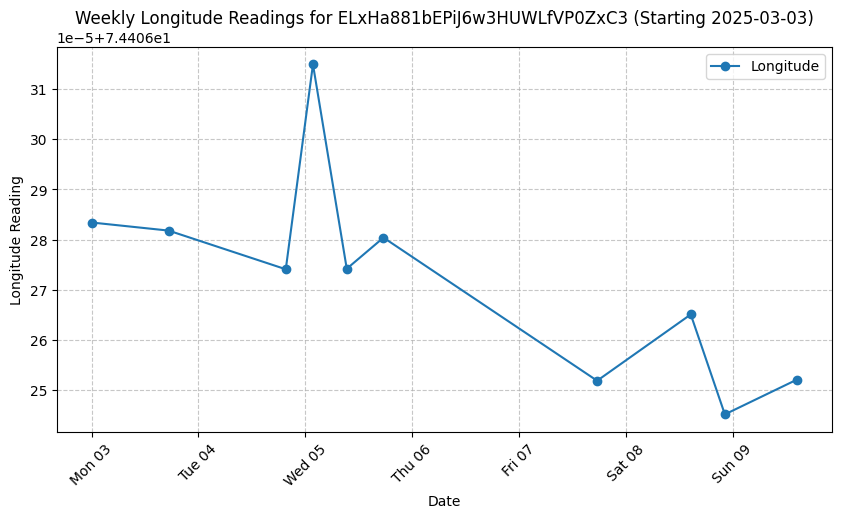

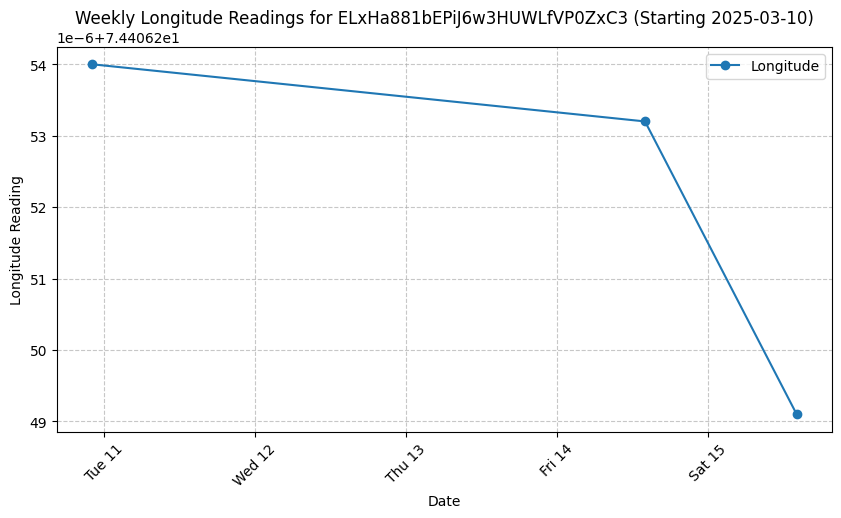

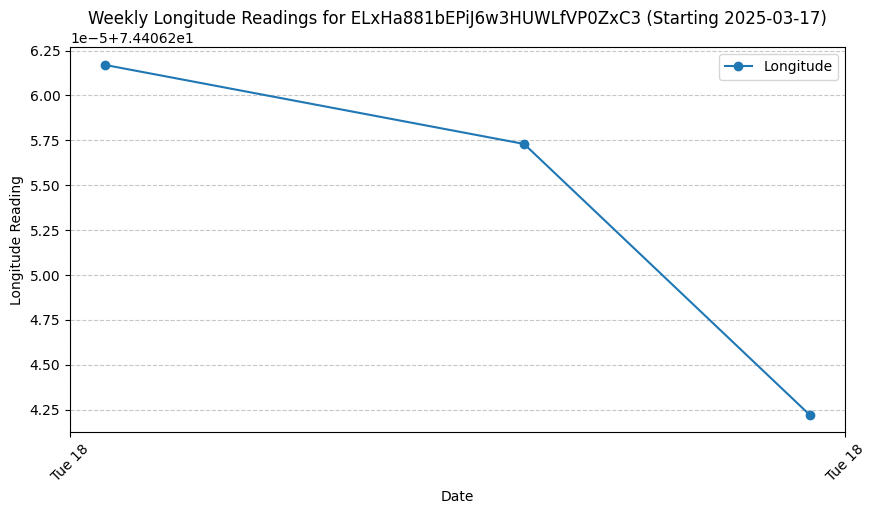

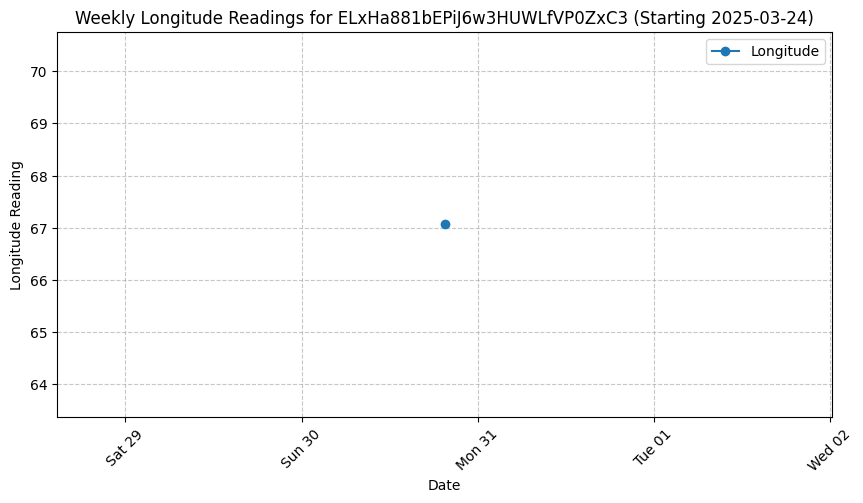


Processing user: Qm9YlAxAdRMKDCyDePxaj2rgx3k1


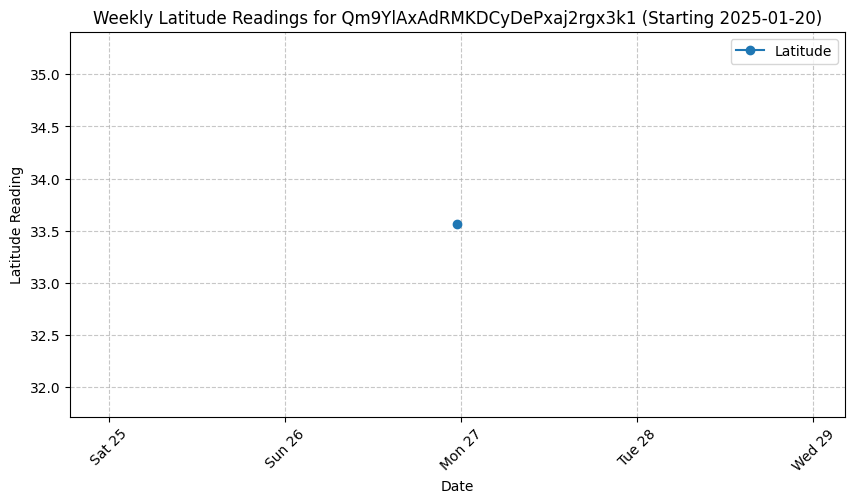

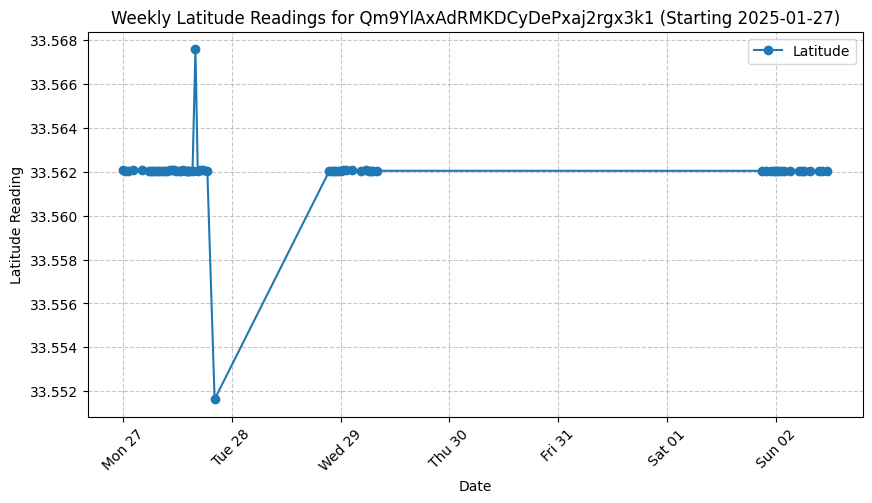

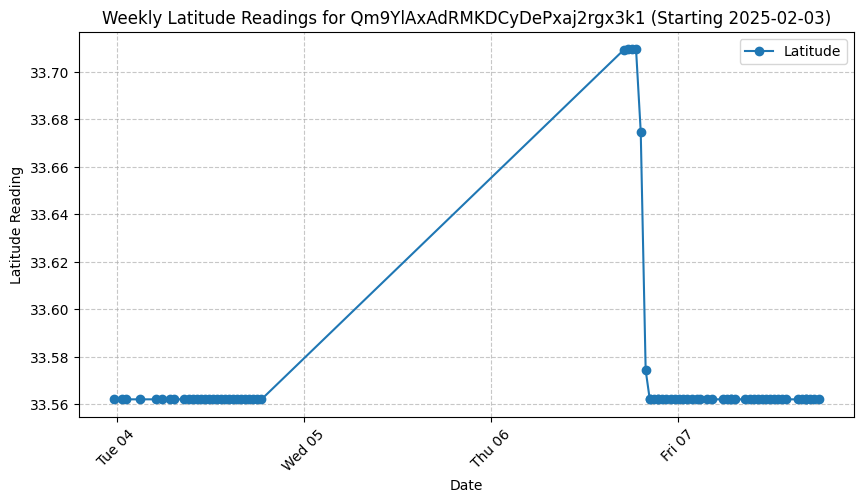

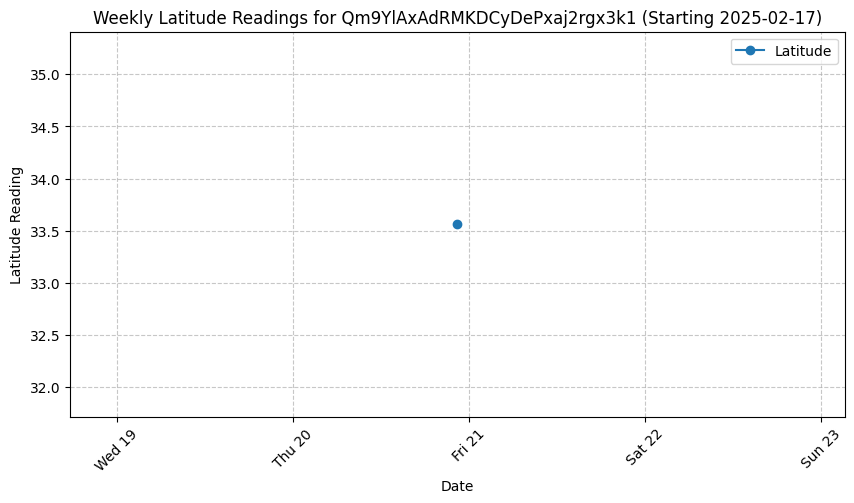

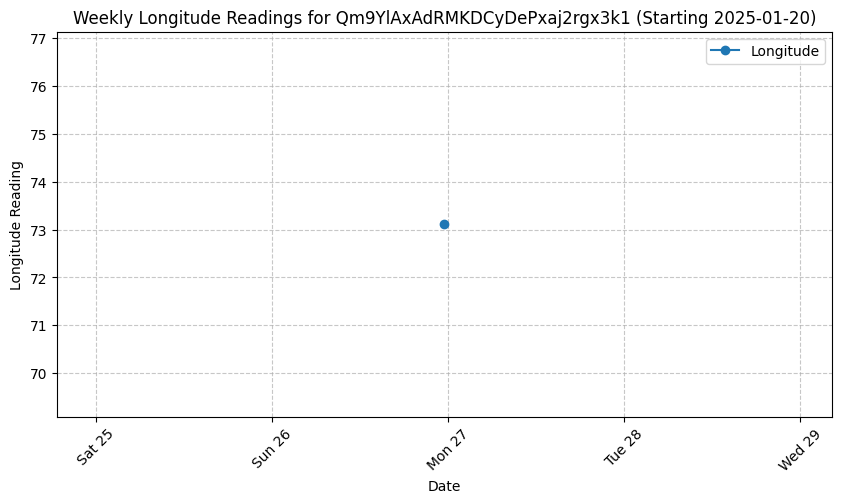

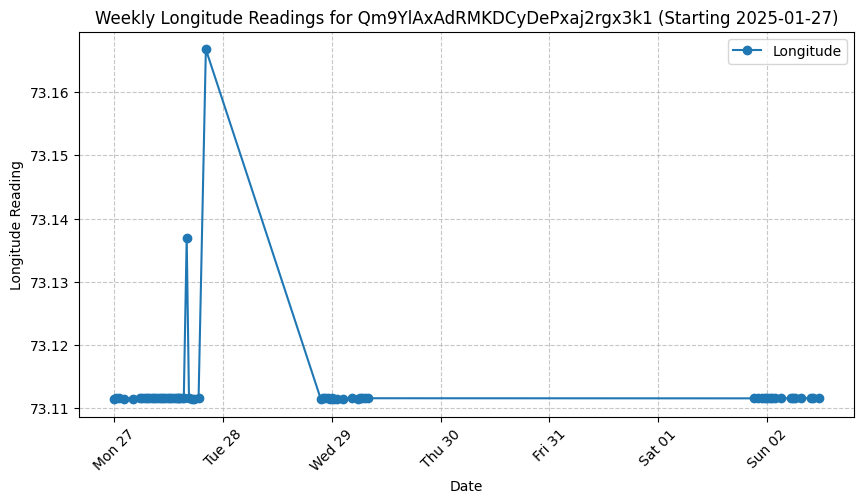

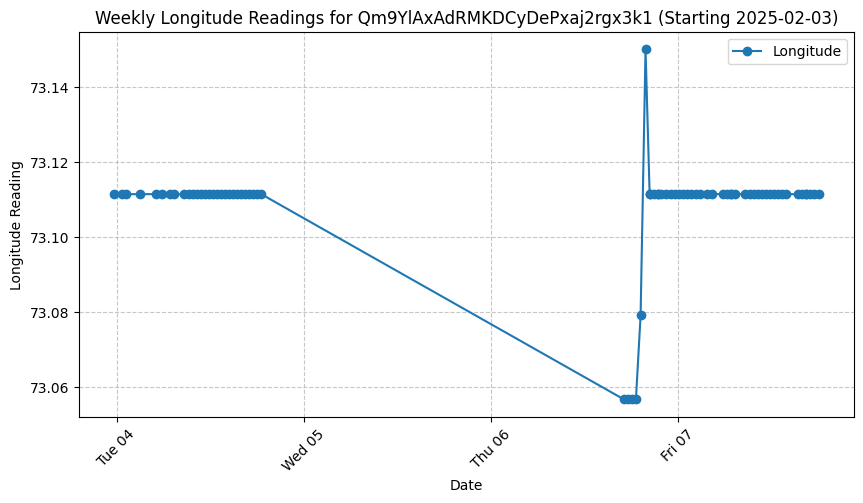

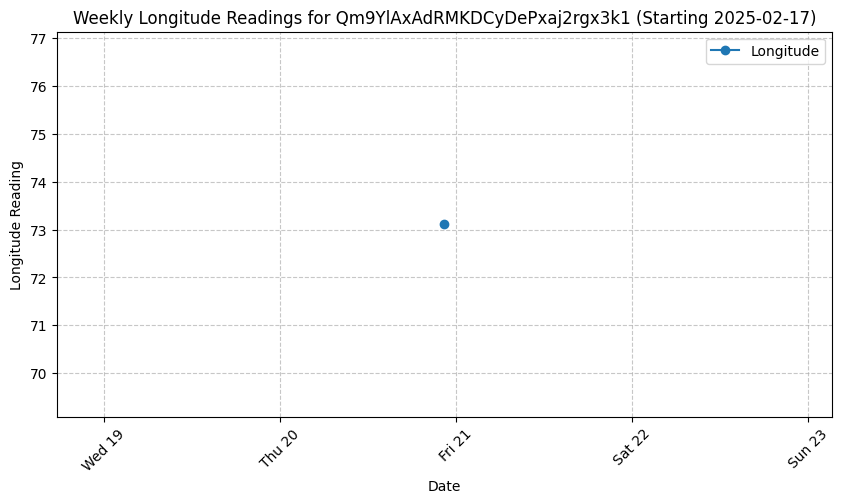


Processing user: TroIjiUCjsdtCrXpE4MsXxHS68h2
ℹ No Latitude readings available for user TroIjiUCjsdtCrXpE4MsXxHS68h2.
ℹ No Longitude readings available for user TroIjiUCjsdtCrXpE4MsXxHS68h2.

Processing user: UbDrbFvC1id1qKqNxGLAkIQ5wAQ2
ℹ No Latitude readings available for user UbDrbFvC1id1qKqNxGLAkIQ5wAQ2.
ℹ No Longitude readings available for user UbDrbFvC1id1qKqNxGLAkIQ5wAQ2.

Processing user: YwkUJbOPNIfm4NEcYDIvnF67vNv2
ℹ No Latitude readings available for user YwkUJbOPNIfm4NEcYDIvnF67vNv2.
ℹ No Longitude readings available for user YwkUJbOPNIfm4NEcYDIvnF67vNv2.

Processing user: fJZyTzEnJiau0FCHMST8msu1XqE2


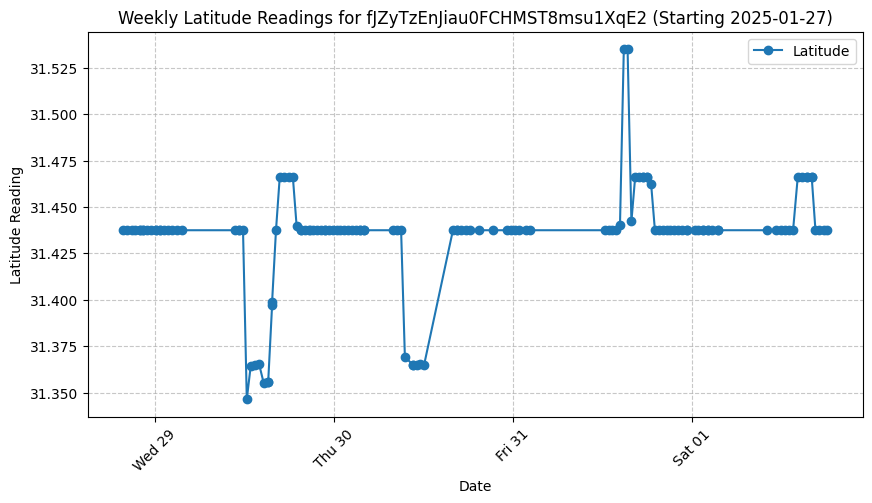

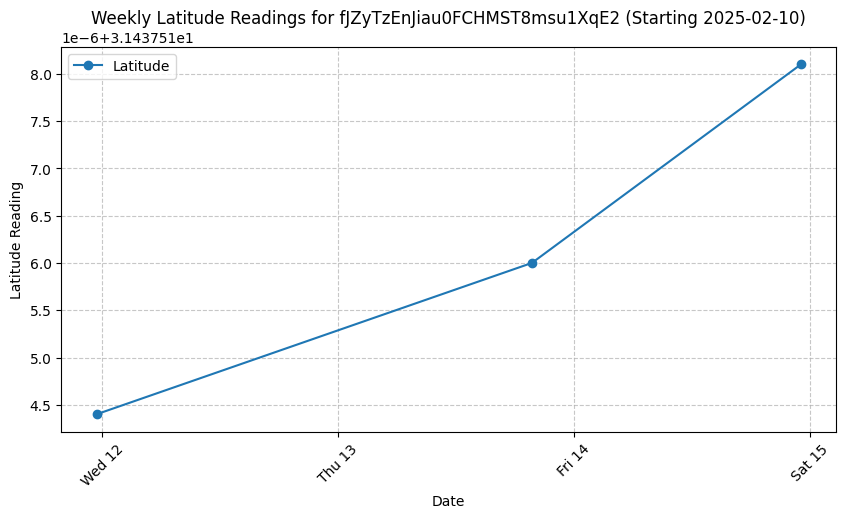

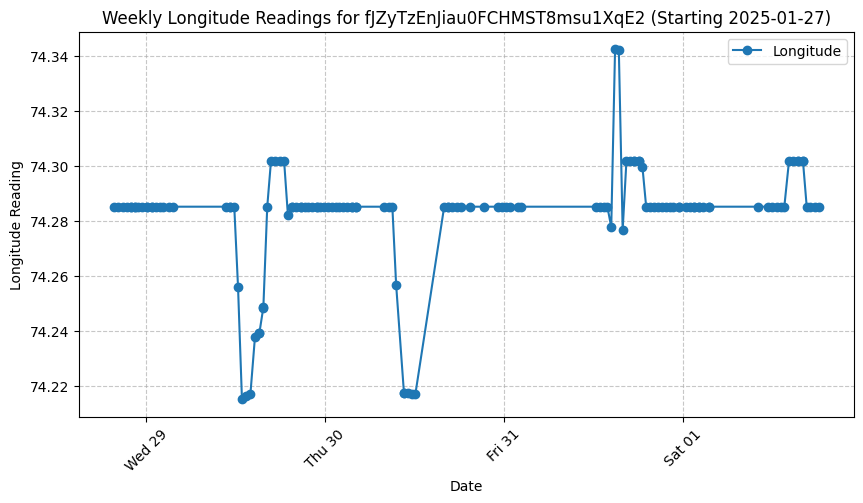

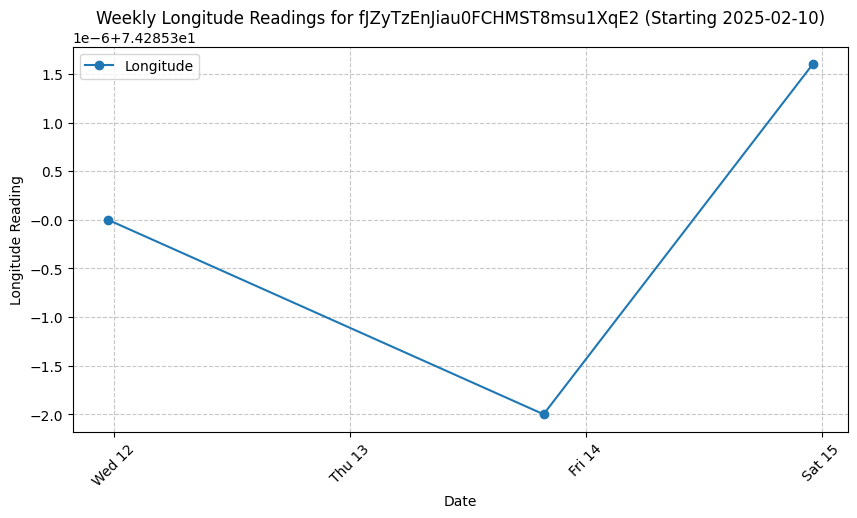


Processing user: t8p0YeBANpeO8OK1ZMkukoopiz82


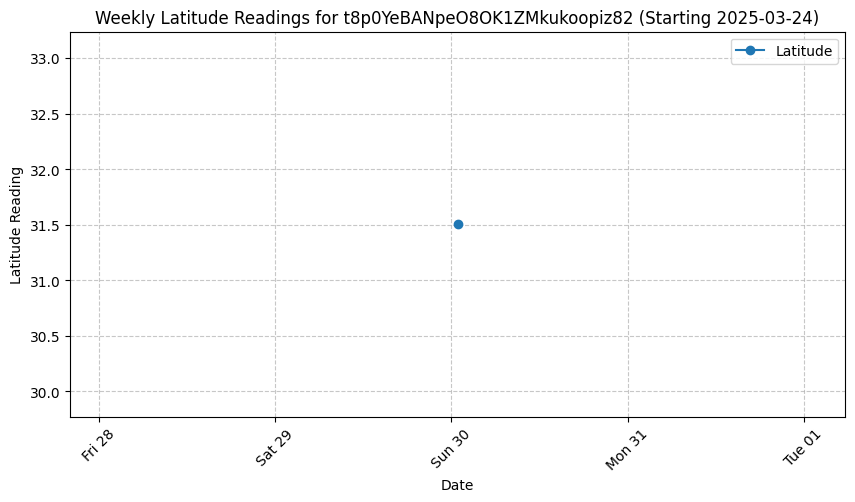

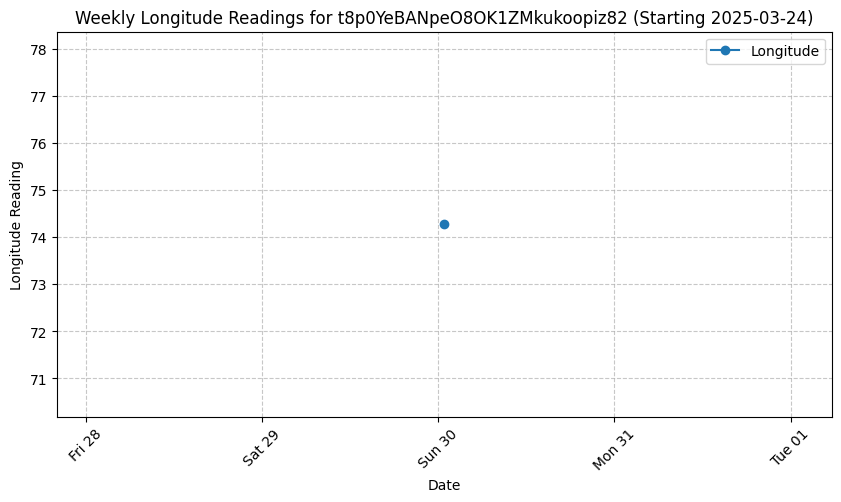


Processing user: zLgCd28bDmfsj5fdr3W02sOFv0H3


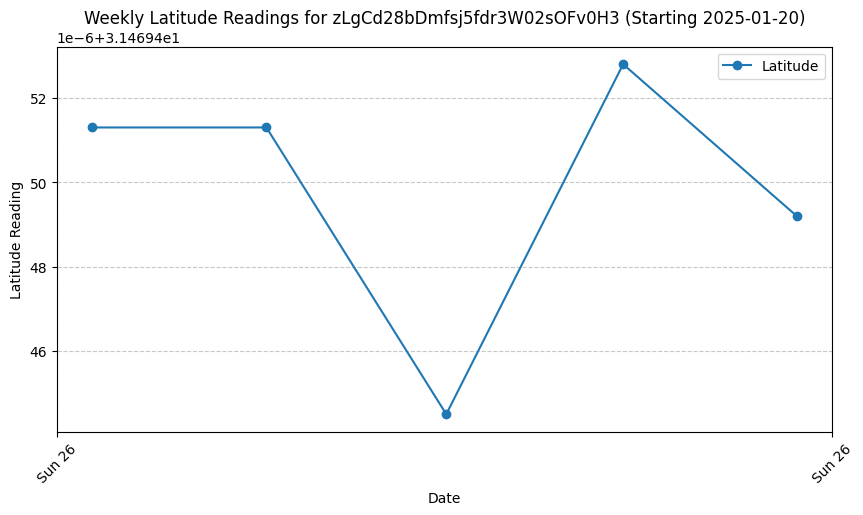

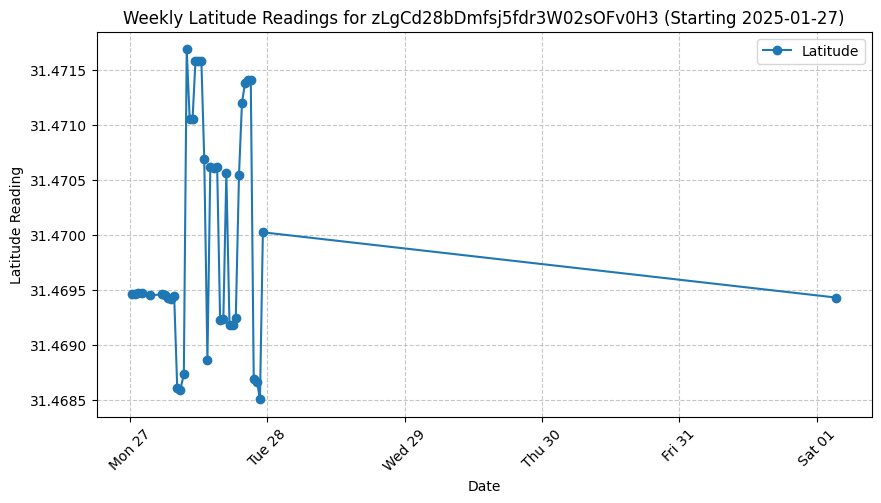

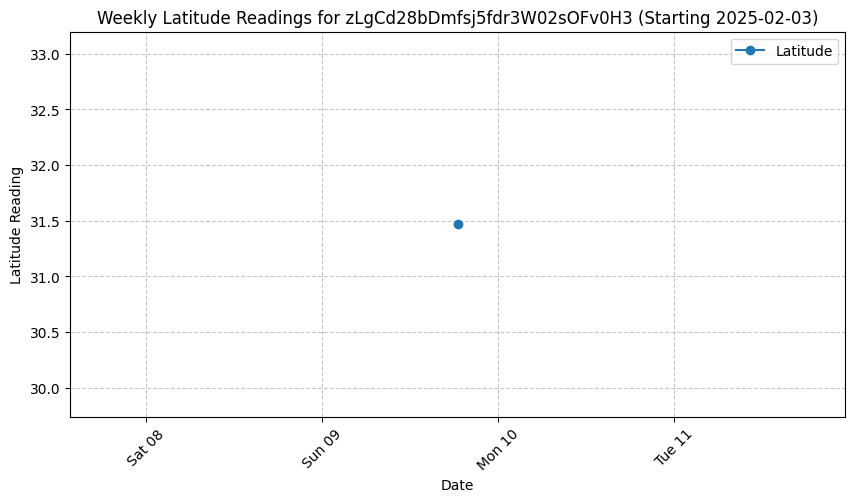

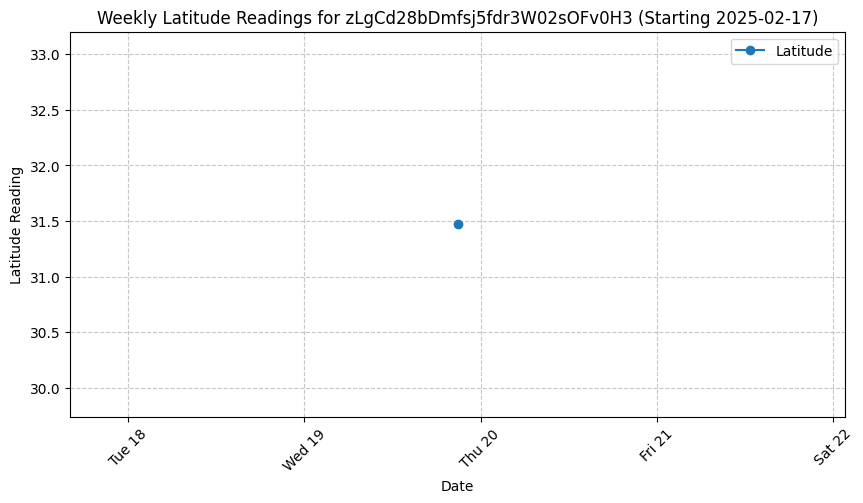

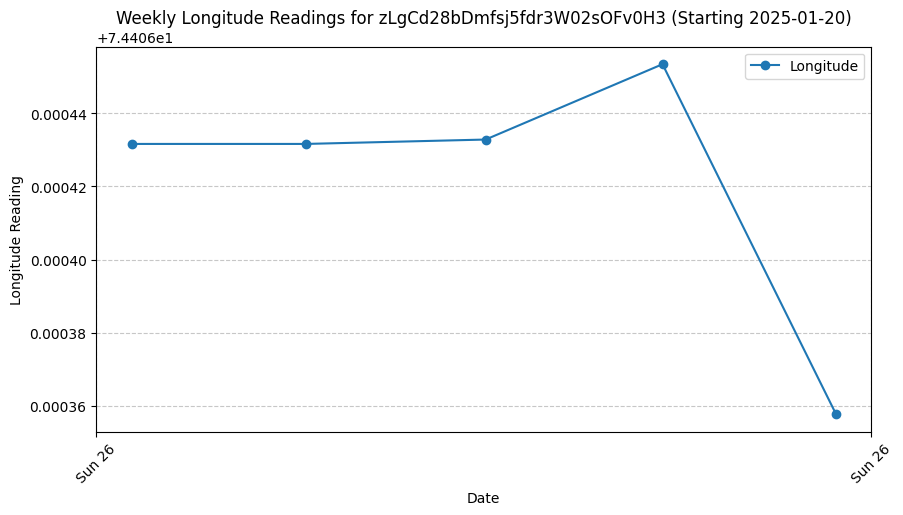

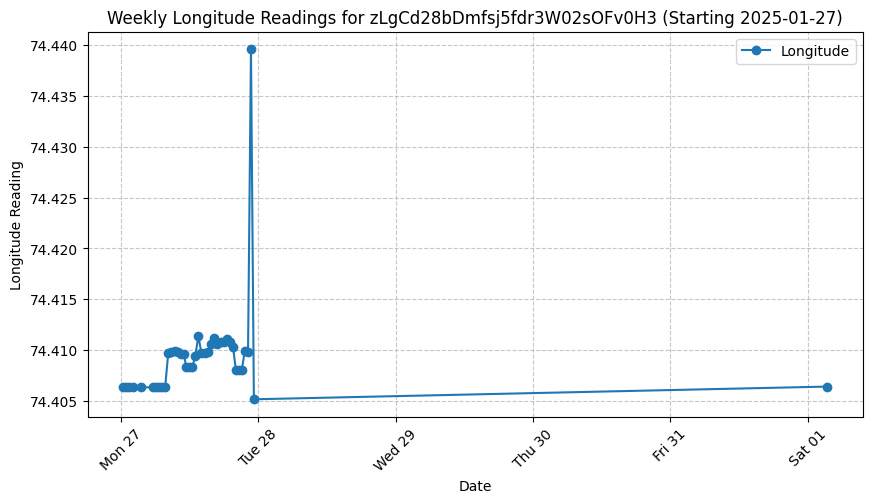

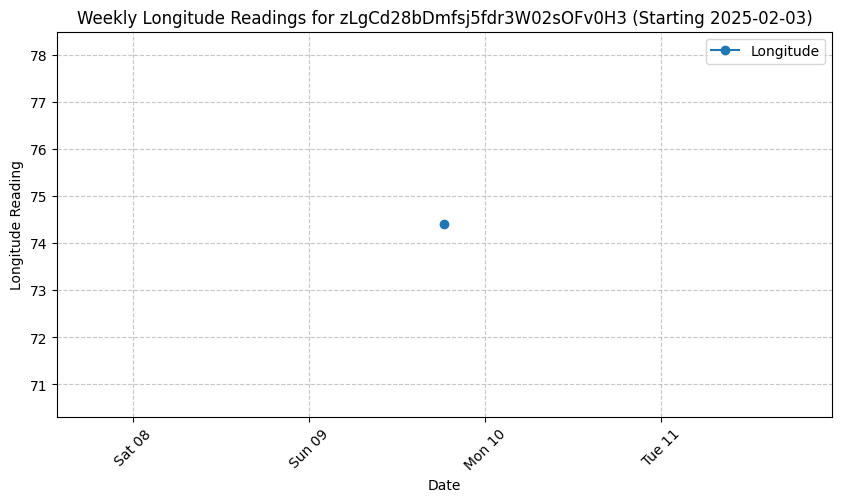

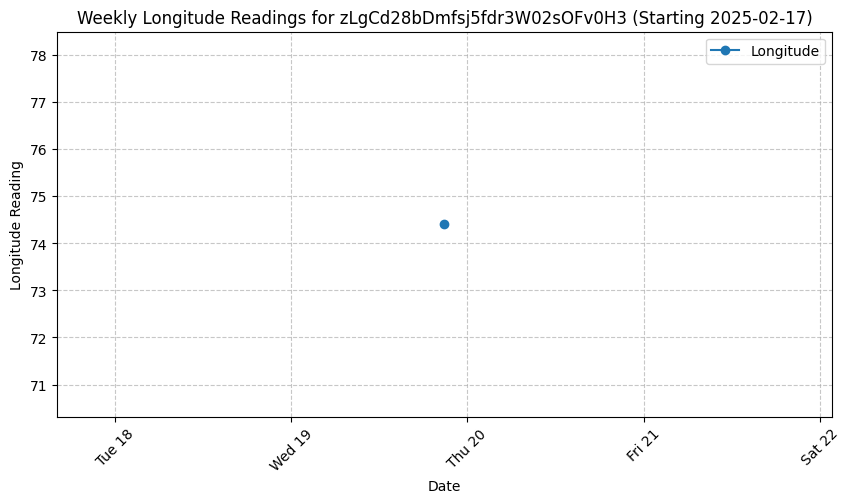

In [18]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import datetime
import os

def process_user_location(user_id, data):
    user_data = data["users"].get(user_id, {})
    data_collection = user_data.get("dataCollection", {})

    lat_timestamps, lat_values = [], []
    long_timestamps, long_values = [], []

    if data_collection:
        for sensor_data in data_collection.values():
            if isinstance(sensor_data, dict):
                if "latitude" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    latitude = sensor_data["latitude"]
                    if isinstance(timestamp, int):
                        lat_timestamps.append(timestamp)
                        lat_values.append(latitude)
                    elif isinstance(timestamp, list) and isinstance(latitude, list):
                        lat_timestamps.extend(timestamp)
                        lat_values.extend(latitude)

                if "longitude" in sensor_data and "timestamp" in sensor_data:
                    timestamp = sensor_data["timestamp"]
                    longitude = sensor_data["longitude"]
                    if isinstance(timestamp, int):
                        long_timestamps.append(timestamp)
                        long_values.append(longitude)
                    elif isinstance(timestamp, list) and isinstance(longitude, list):
                        long_timestamps.extend(timestamp)
                        long_values.extend(longitude)

    lat_sorted = sorted(zip(lat_timestamps, lat_values)) if lat_timestamps else []
    long_sorted = sorted(zip(long_timestamps, long_values)) if long_timestamps else []

    lat_timestamps, lat_values = zip(*lat_sorted) if lat_sorted else ([], [])
    long_timestamps, long_values = zip(*long_sorted) if long_sorted else ([], [])

    return lat_timestamps, lat_values, long_timestamps, long_values


def plot_weekly_readings(user_id, timestamps, values, label):
    if not timestamps:
        print(f"ℹ No {label} readings available for user {user_id}.")
        return

    timestamps = [datetime.datetime.fromtimestamp(t / 1000) for t in timestamps]

    weekly_data = {}
    for t, v in zip(timestamps, values):
        week_start = (t - datetime.timedelta(days=t.weekday())).strftime("%Y-%m-%d")
        if week_start not in weekly_data:
            weekly_data[week_start] = ([], [])
        weekly_data[week_start][0].append(t)
        weekly_data[week_start][1].append(v)

    output_dir = "weekly_location_plots"
    os.makedirs(output_dir, exist_ok=True)

    for week, (times, readings) in weekly_data.items():
        plt.figure(figsize=(10, 5))
        plt.plot(times, readings, marker="o", linestyle="-", label=label)
        plt.xlabel("Date")
        plt.ylabel(f"{label} Reading")
        plt.title(f"Weekly {label} Readings for {user_id} (Starting {week})")

        plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=1))
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%a %d"))
        plt.xticks(rotation=45)

        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.7)

        plt.savefig(os.path.join(output_dir, f"user_{user_id}_{label.lower()}_week_{week}.png"))
        plt.show()


# filtered_users = ["user1", "user2", "user3"]  # Replace with actual filtered user IDs

for user_id in filtered_users:
    print(f"\nProcessing user: {user_id}")
    lat_timestamps, lat_values, long_timestamps, long_values = process_user_location(user_id, data)
    plot_weekly_readings(user_id, lat_timestamps, lat_values, "Latitude")
    plot_weekly_readings(user_id, long_timestamps, long_values, "Longitude")
